## Вводные

In [1]:
from Bio.Seq import MutableSeq #or import Bio.Seq, но тогда вводить Bio.Seq.Seq("")
from Bio.Seq import Seq
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
from Bio.Data.CodonTable import unambiguous_dna_by_id
from Bio.SeqUtils import seq3
import seaborn as sns
import os
import random
from scipy.stats import spearmanr
from scipy.stats import pearsonr
from scipy.stats import mannwhitneyu as MW
from scipy.spatial import distance

from Bio.Data.CodonTable import unambiguous_dna_by_id
table = 2

aa_dict = {}
for c in unambiguous_dna_by_id[table].forward_table:
    if unambiguous_dna_by_id[table].forward_table[c] not in aa_dict:
        aa_dict[unambiguous_dna_by_id[table].forward_table[c]] = []
    aa_dict[unambiguous_dna_by_id[table].forward_table[c]].append(c)
aa_dict['_'] = unambiguous_dna_by_id[table].stop_codons

class_list = ['Actinopterygii', 'Amphibia', 'Reptilia', 'Aves', 'Mammalia']

set_set = set()
for i in class_list:
    for j in class_list:
        if i != j:
            set_set.add(frozenset([i, j]))

sim_AllGenes_Shift = os.listdir('Practice\Results_AllGenes_shift')

cs_all = pd.read_csv('Practice\\CrossSpeciesAll.csv', sep='\t').copy()

aa_dict

{'F': ['TTT', 'TTC'],
 'L': ['TTA', 'TTG', 'CTT', 'CTC', 'CTA', 'CTG'],
 'S': ['TCT', 'TCC', 'TCA', 'TCG', 'AGT', 'AGC'],
 'Y': ['TAT', 'TAC'],
 'C': ['TGT', 'TGC'],
 'W': ['TGA', 'TGG'],
 'P': ['CCT', 'CCC', 'CCA', 'CCG'],
 'H': ['CAT', 'CAC'],
 'Q': ['CAA', 'CAG'],
 'R': ['CGT', 'CGC', 'CGA', 'CGG'],
 'I': ['ATT', 'ATC'],
 'M': ['ATA', 'ATG'],
 'T': ['ACT', 'ACC', 'ACA', 'ACG'],
 'N': ['AAT', 'AAC'],
 'K': ['AAA', 'AAG'],
 'V': ['GTT', 'GTC', 'GTA', 'GTG'],
 'A': ['GCT', 'GCC', 'GCA', 'GCG'],
 'D': ['GAT', 'GAC'],
 'E': ['GAA', 'GAG'],
 'G': ['GGT', 'GGC', 'GGA', 'GGG'],
 '_': ['TAA', 'TAG', 'AGA', 'AGG']}

In [2]:
ms = pd.read_csv('Practice/VertebratePolymorphisms.MutSpecData.OnlyFourFoldDegAllGenes.csv', sep=' ').copy()

zero_dict = {}
for species in os.listdir('Practice\\Results_AllGenes_shift'):
    zeros = 0
    for i in ms[ms.Species == species].values[0].tolist()[1:]:
        if i == 0:
            zeros += 1
    zero_dict[species] = zeros
    
zero_4 = []
zero_5 = []
zero_6 = []
for i in zero_dict:
    if zero_dict[i] <= 4:
        zero_4.append(i)
    if zero_dict[i] <= 5:
        zero_5.append(i)
    if zero_dict[i] <= 6:
        zero_6.append(i)

print(f'Analysed species number: {len(sim_AllGenes_Shift)}')
print(f'Analysed species number with only 6 zeros in MS: {len(zero_6)}')
print(f'Analysed species number with only 5 zeros in MS: {len(zero_5)}')
print(f'Analysed species number with only 4 zeros in MS: {len(zero_4)}')

Analysed species number: 560
Analysed species number with only 6 zeros in MS: 505
Analysed species number with only 5 zeros in MS: 454
Analysed species number with only 4 zeros in MS: 400


In [1]:
pwd

'c:\\Work\\Lab'

# Диаграмма рассеяния

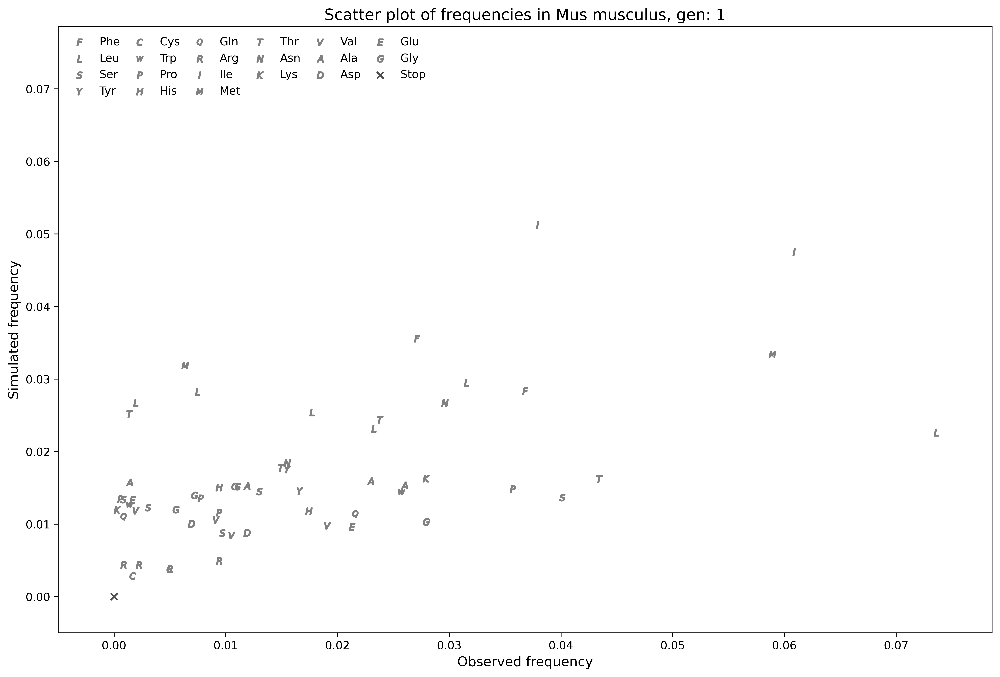

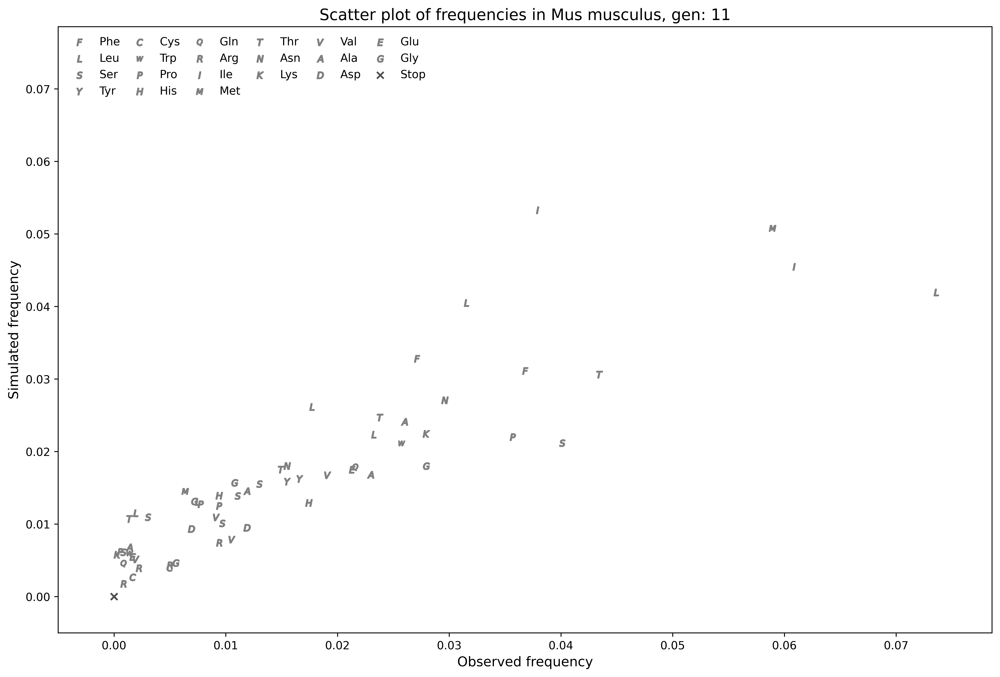

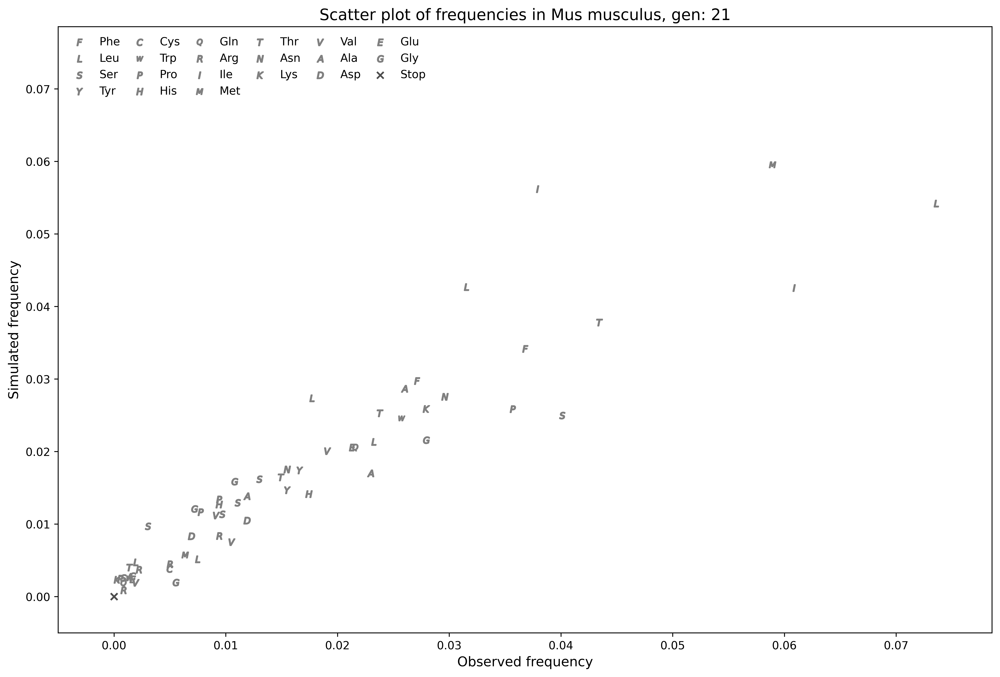

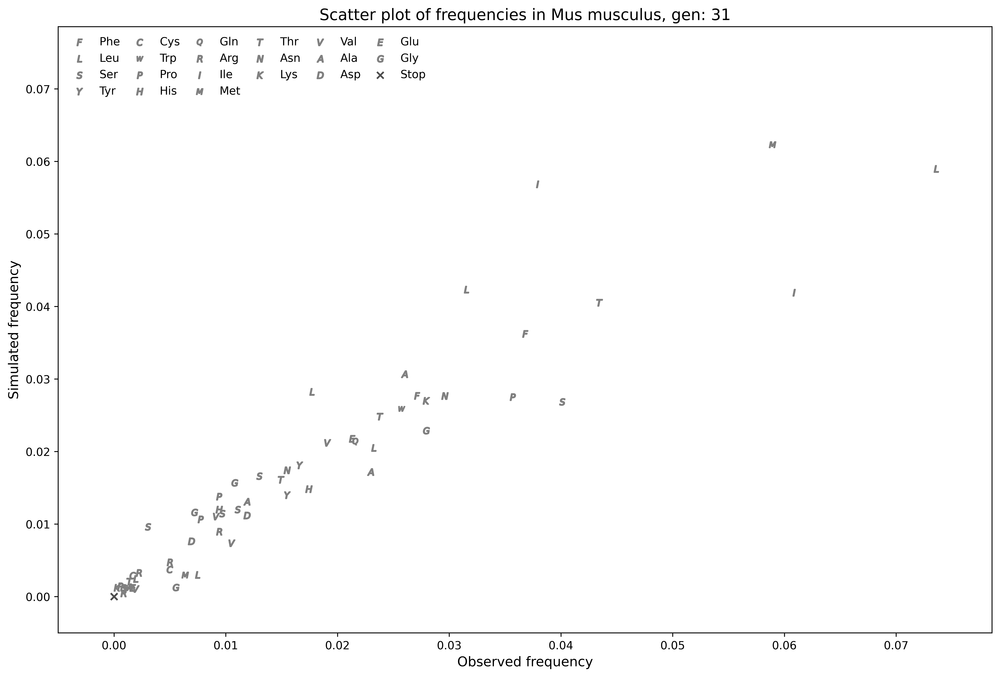

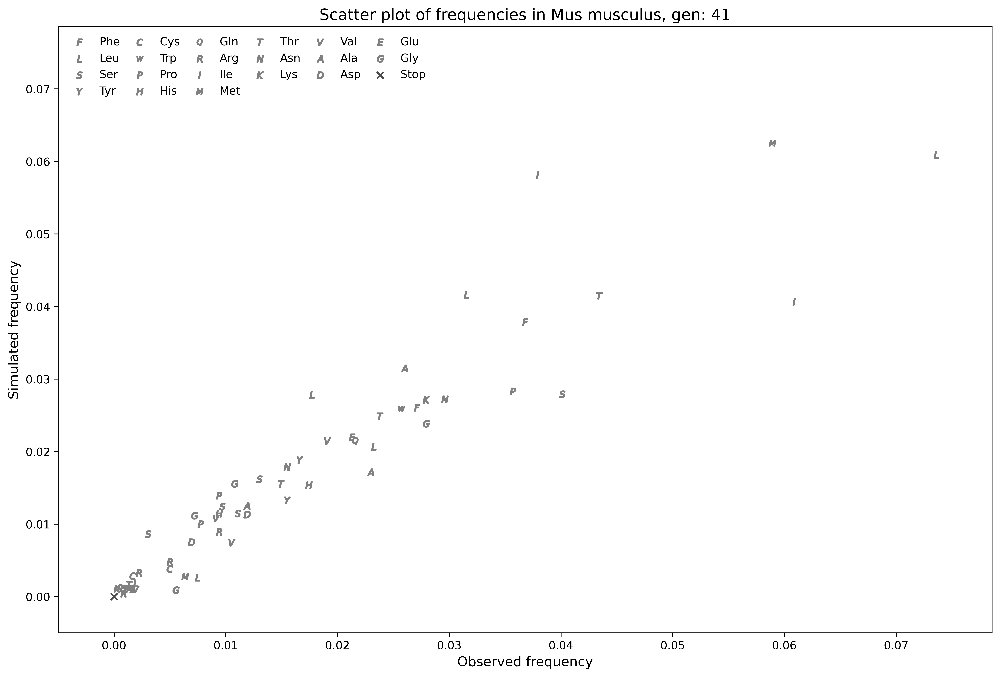

...

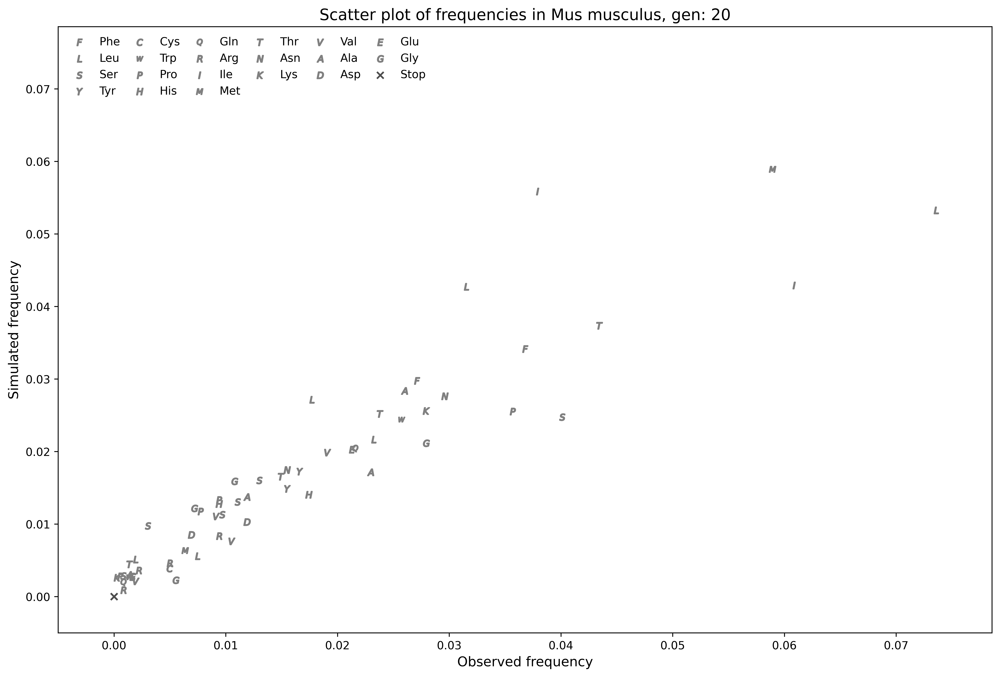

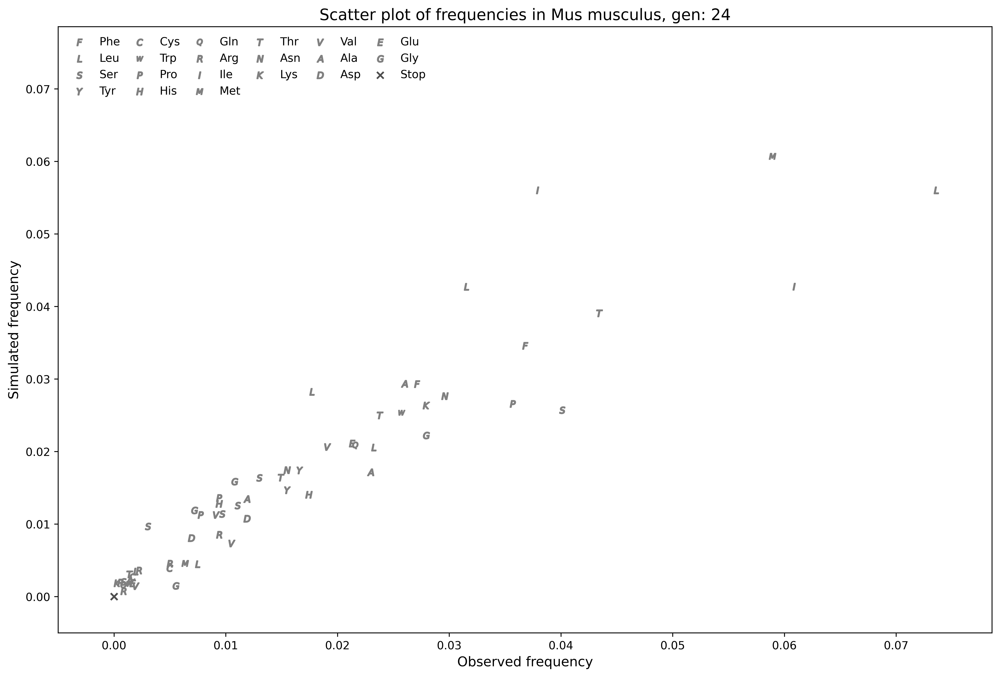

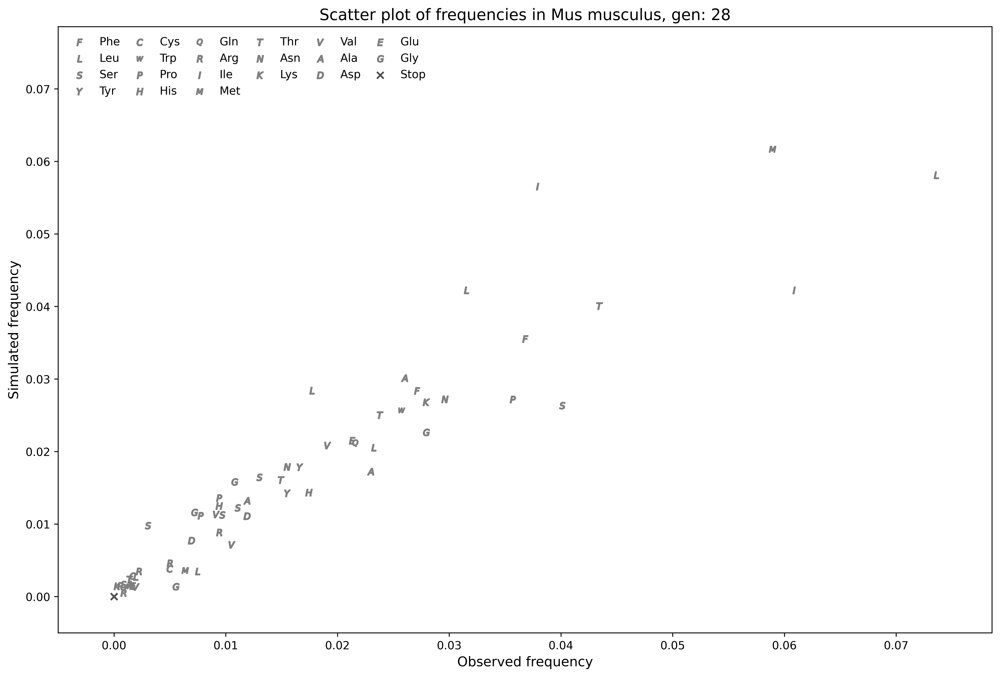

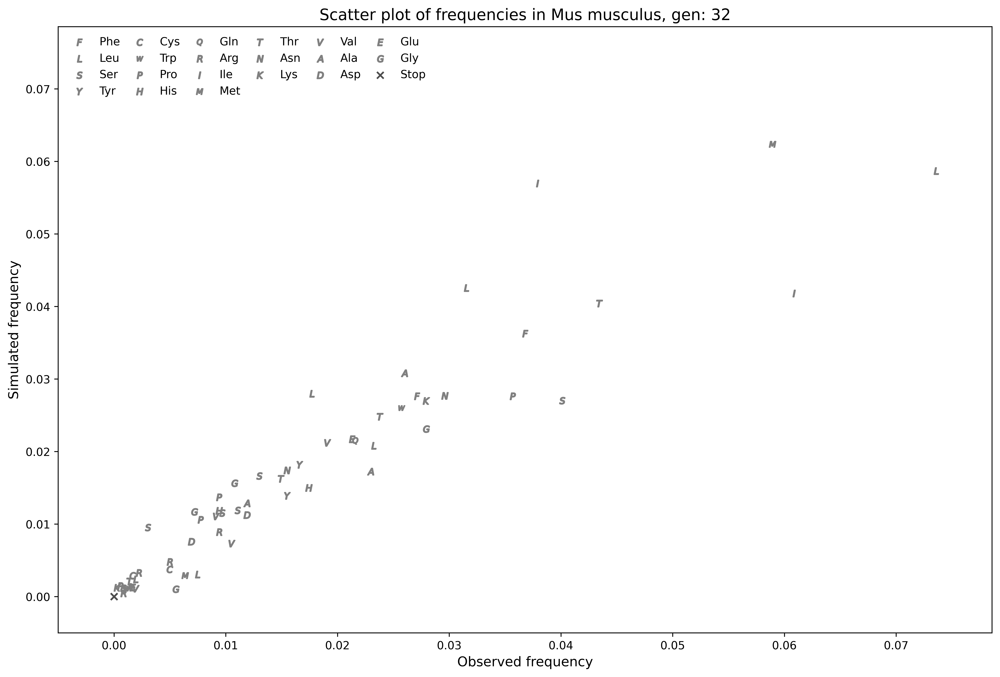

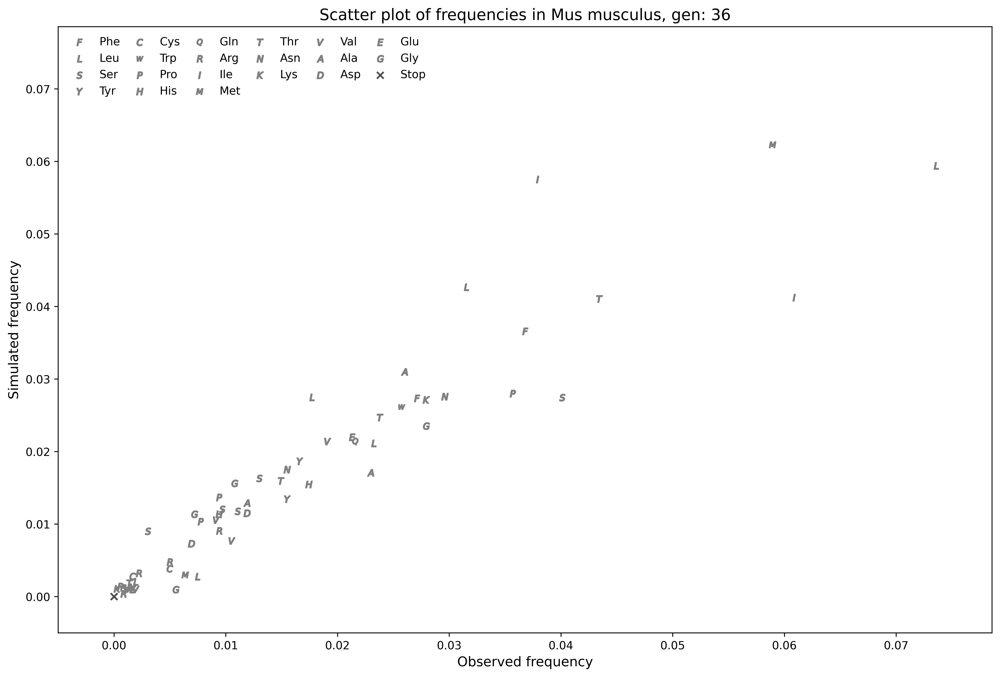

In [58]:
species_list = ['Mus_musculus'] 

for species in species_list:
    generations = 225
    os.makedirs('Course work pictures\\{}\\Letter_scatter\\'.format(species), exist_ok=True)

    data = pd.read_csv('Practice\\Results_AllGenes_shift\\{}\FrequenciesMean.csv'.format(species), sep='\t').copy()

    # [gen+1 for gen in range(0,generations,10)]
    # [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 16, 18, 20, 24, 28, 32, 36, 40, 50, 60, 70, 90, 120, 150]
    for gen in [gen+1 for gen in range(0,generations,10)] + [2, 3, 4, 5, 6, 7, 8, 9, 12, 14, 16, 18, 20, 24, 28, 32, 36]:
        plt.figure(figsize=(15, 10), dpi=600)
        for aa in aa_dict:
            obs = []
            sim = []
            for codon in aa_dict[aa]:
                obs.append(data[codon].loc[0])
                sim.append(data[codon].loc[gen])
            if aa == '_':
                plt.scatter(obs,sim, label='Stop', marker='x', c='0.3')
            else:
                plt.scatter(obs,sim, label=seq3(aa), marker='${}$'.format(aa), c='0.5')
            plt.legend(columnspacing=0.75 ,ncol=6, loc='upper left', frameon=False, fontsize=10)
        plt.ylim(-0.005, data.values.max()+0.005)
        plt.xlim(-0.005, data.loc[0].max()+0.005)
        plt.xlabel('Observed frequency', fontsize=12)
        plt.ylabel('Simulated frequency', fontsize=12)
        plt.title('Scatter plot of frequencies in {}, gen: {}'.format(species.replace('_', ' '), gen), fontsize=14)
        plt.savefig('Course work pictures\\{}\\Letter_scatter\\{}'.format(species, gen), bbox_inches='tight')
        plt.show()

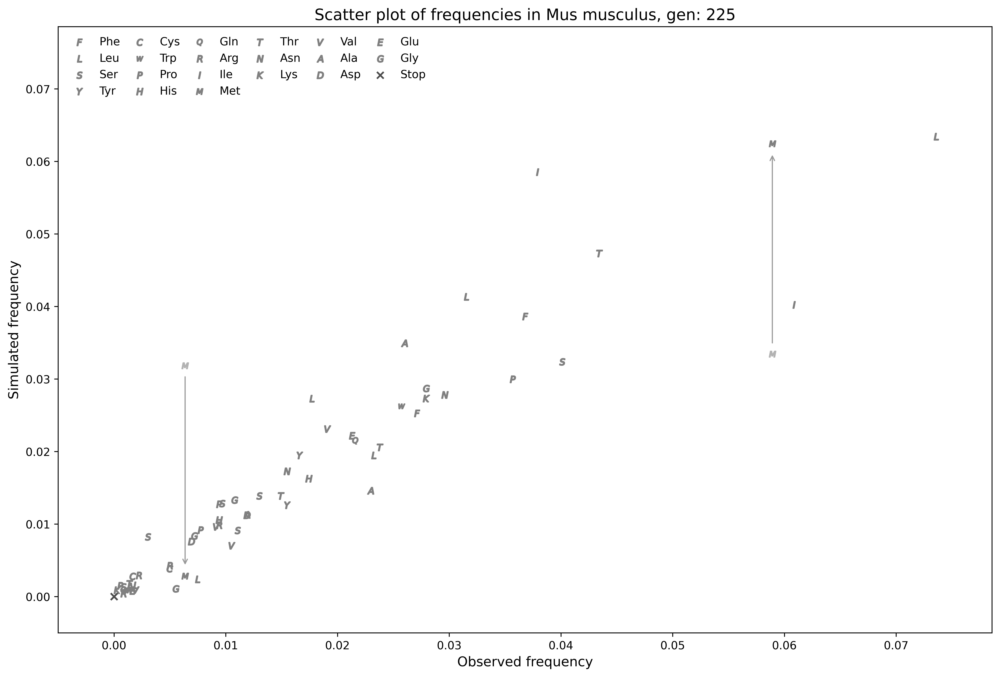

In [62]:
# species = 'Mus_musculus'
# data = pd.read_csv('Practice\\Results_AllGenes_shift\\{}\FrequenciesMean.csv'.format(species), sep='\t').copy()
gen = 225

plt.figure(figsize=(15, 10), dpi=600) #  'M': ['ATA', 'ATG'],
                                      #  'T': ['ACT', 'ACC', 'ACA', 'ACG'],
    
HT1 = 'ATA'
HT2 = 'ATG'

for aa in aa_dict:
    obs = []
    sim = []
    for codon in aa_dict[aa]:
        obs.append(data[codon].loc[0])
        sim.append(data[codon].loc[gen])
    if aa == '_':
        plt.scatter(obs,sim, label='Stop', marker='x', c='0.3')
    else:
        plt.scatter(obs,sim, label=seq3(aa), marker='${}$'.format(aa), c='0.5')
    plt.legend(columnspacing=0.75 ,ncol=6, loc='upper left', frameon=False)
plt.ylim(-0.005, data.values.max()+0.005)
plt.xlim(-0.005, data.loc[0].max()+0.005)
plt.xlabel('Observed frequency', fontsize=12)
plt.ylabel('Simulated frequency', fontsize=12)
plt.title('Scatter plot of frequencies in {}, gen: {}'.format(species.replace('_', ' '), gen), fontsize=14)

plt.scatter(data[HT1].loc[0], data[HT1].loc[1], marker='${}$'.format('M'), c='0.7')
plt.annotate("",
            xy=(data[HT1].loc[0], data[HT1].loc[gen]), xycoords='data',
            xytext=(data[HT1].loc[0], data[HT1].loc[1]), textcoords='data',
            arrowprops=dict(arrowstyle="->",
                            connectionstyle="arc3", color="0.6",
                            shrinkA=10, shrinkB=10))

plt.scatter(data[HT2].loc[0], data[HT2].loc[1], marker='${}$'.format('M'), c='0.7')
plt.annotate("",
            xy=(data[HT2].loc[0], data[HT2].loc[gen]), xycoords='data',
            xytext=(data[HT2].loc[0], data[HT2].loc[1]), textcoords='data',
            arrowprops=dict(arrowstyle="->",
                            connectionstyle="arc3", color="0.6",
                            shrinkA=10, shrinkB=10))

plt.savefig('Course work pictures\\{}\\Letter_scatter\\{}'.format(species, gen), bbox_inches='tight')
plt.show()

In [19]:
import imageio as iio
species_list = ['Mus_musculus']
for species in species_list:
    images = []
    filenames = sorted(os.listdir('Course work pictures\\{}\\Letter_scatter'.format(species)), 
                       key=lambda x: int(x[:-4])) # сортировка по имении без расширения
    for i in range(len(filenames)): # приписываем полный путь
        filenames[i] = 'Course work pictures\\{}\\Letter_scatter\\{}'.format(species, filenames[i])

    for filename in filenames:
        images.append(iio.imread(filename))
    iio.mimsave('Course work pictures\\{}\\Letter_scatter\\gif.gif'.format(species), images, duration=0.3)

In [25]:
from PIL import Image
gif = []
images = [Image.open(i) for i in filenames]#images, just convert it into PIL.Image obj
for image in images:
    gif.append(image.convert("P",palette=Image.ADAPTIVE))
gif[0].save('Course work pictures\\{}\\Letter_scatter\\PIL.gif'.format(species), save_all=True, optimize=False, append_images=gif[1:], loop=0)

# Насыщение

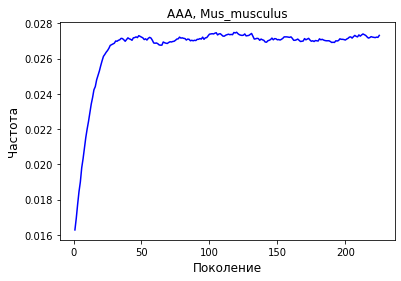

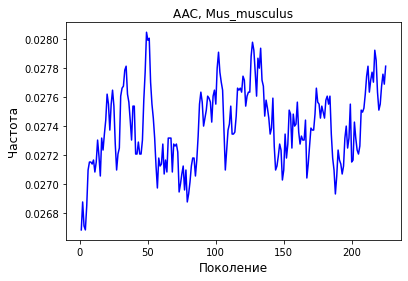

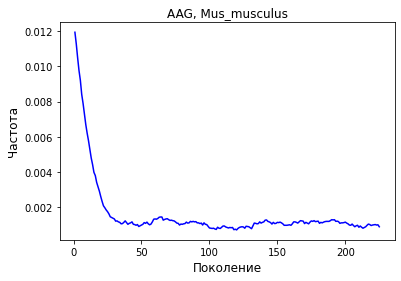

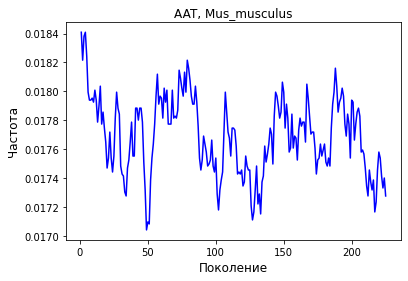

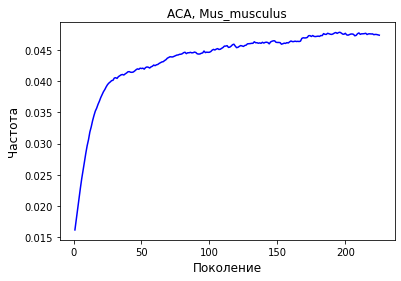

...

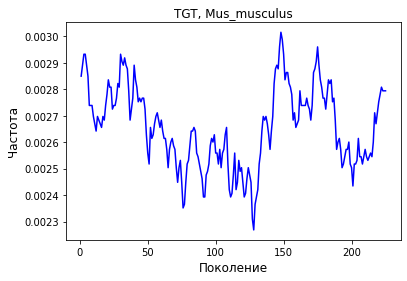

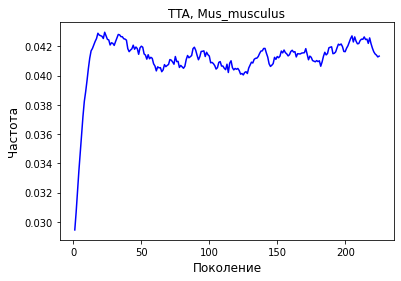

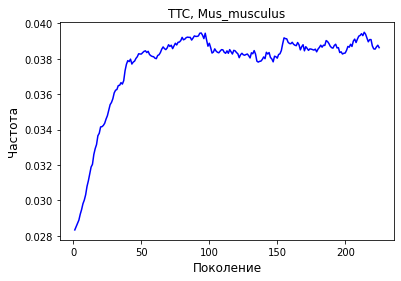

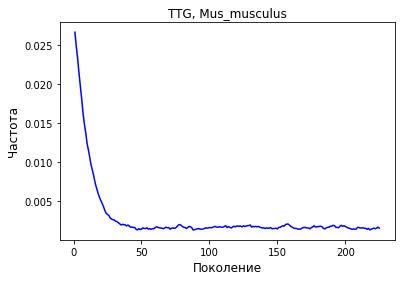

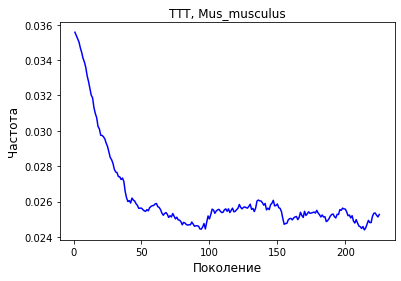

In [26]:
for species in species_list:
# species = 'Mus_musculus'
    df = pd.read_csv('Practice\\Results_AllGenes_shift\\{}\FrequenciesMean.csv'.format(species), sep='\t').copy()
    df = df.drop(0)
    df = df.astype(float)
    os.makedirs("Practice\\Results_AllGenes_shift\\{}\\Codons saturation\\".format(species), exist_ok=True)
    
    for column in df:
        df1 = df[column]
        df1.plot(color = 'blue')
        plt.title('{}, {}'.format(column, species))
        plt.xlabel('Поколение', fontsize=12)
        plt.ylabel('Частота', fontsize=12)
        # plt.savefig('Practice\\Results_NewGen\\{}\Codons saturation\{}.png'.format(species, column))
        plt.show()

# Дельта Ро 20 образцов и их средняя

In [59]:
subzero = []
deltaRho_AllGenes_Shift = {}   # value = list of 225 numbers
for species in sim_AllGenes_Shift:
    spearman_mean = pd.read_csv('Practice\\Results_AllGenes_shift\{}\SpearmanMean.csv'.format(species), sep='\t').copy()
    deltaRho_AllGenes_Shift[species] = []
    for spearman_value in spearman_mean.spearman.values:
        deltaRho_AllGenes_Shift[species].append(spearman_value - spearman_mean.spearman.values[0])
    if spearman_mean.spearman.values[200] - spearman_mean.spearman.values[0] < 0:
        subzero.append(species)
print(len(subzero)/len(sim_AllGenes_Shift))
print(subzero)

0.02857142857142857
['Abramis_brama', 'Acheilognathus_somjinensis', 'Anguilla_rostrata', 'Anguis_fragilis', 'Capra_sibirica', 'Chuanchia_labiosa', 'Cyprinodon_rubrofluviatilis', 'Galaxias_maculatus', 'Genetta_servalina', 'Gila_robusta', 'Grus_antigone', 'Hexagrammos_otakii', 'Murina_leucogaster', 'Nycticebus_bengalensis', 'Sardina_pilchardus', 'Trachurus_trachurus']


In [4]:
deltaRho_ShiftMean = {}
for species in sim_AllGenes_Shift:
    deltaRho_Shift = {}
    deltaRho_ShiftMean[species] = np.array([0 for i in range(225)])
    for sample in range(20):
        spearman = pd.read_csv('Practice\\Results_AllGenes_shift\{}\{}\Spearman.csv'.format(species, sample), sep='\t').copy()
        deltaRho_Shift[sample] = []

        for spearman_value in spearman.spearman.values:
            deltaRho_Shift[sample].append(spearman_value - spearman.spearman.values[0])
        deltaRho_ShiftMean[species] = deltaRho_ShiftMean[species] + deltaRho_Shift[sample]
    deltaRho_ShiftMean[species] = deltaRho_ShiftMean[species]/20

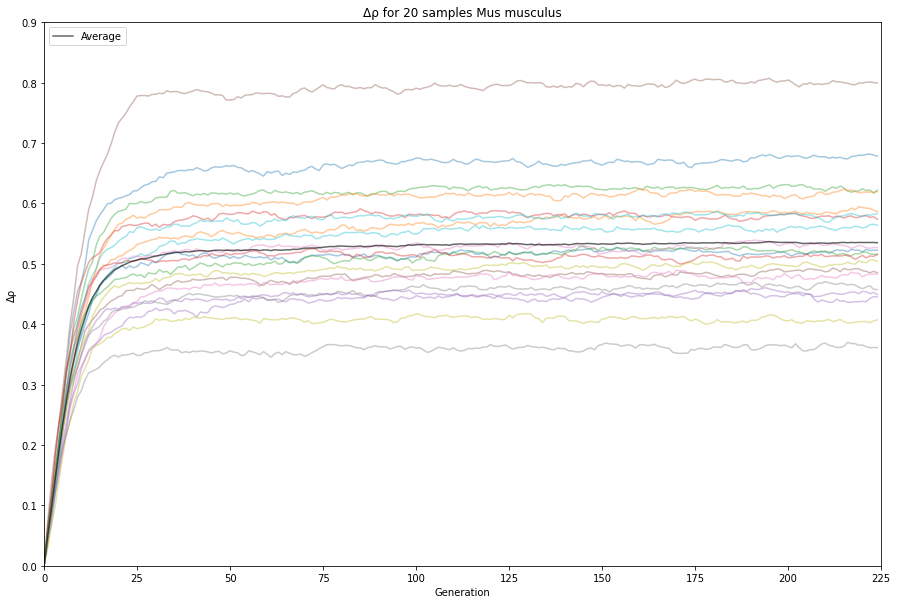

In [215]:
# sim_AllGenes_Shift
for species in ['Mus_musculus']:
    deltaRho_Shift = {}
    plt.figure(figsize=(15, 10))
    for sample in range(20):
        spearman = pd.read_csv('Practice\\Results_AllGenes_shift\{}\{}\Spearman.csv'.format(species, sample), sep='\t').copy()
        deltaRho_Shift[sample] = []
        for spearman_value in spearman.spearman.values:
            deltaRho_Shift[sample].append(spearman_value - spearman.spearman.values[0])
    for sample in deltaRho_Shift:
        plt.plot(deltaRho_Shift[sample], alpha=0.4) # , label = Class

    # plt.plot(deltaRho_AllGenes[species], alpha=0.7, color='black', label = 'Equal odds mean')
    # plt.plot(deltaRho_AllGenes_Shift[species], alpha=0.7, color='black', linestyle='dashed', label = 'Random odds mean')
    plt.plot(deltaRho_ShiftMean[species], alpha=0.6, color='black', label = 'Average')

    plt.xlim(0, 225)
    plt.ylim(0, 0.9)
    plt.xlabel('Generation')
    plt.ylabel('Δρ')
    plt.title('Δρ for 20 samples {}'.format(species.replace('_', ' ')))
    plt.legend(loc='upper left')
    os.makedirs('Course work pictures\\Results_graphs\\deltaRho Shift Mean', exist_ok=True)
    plt.savefig('Course work pictures\\Results_graphs\\deltaRho Shift Mean\\{}.png'.format(species))
    plt.show()
    plt.close()

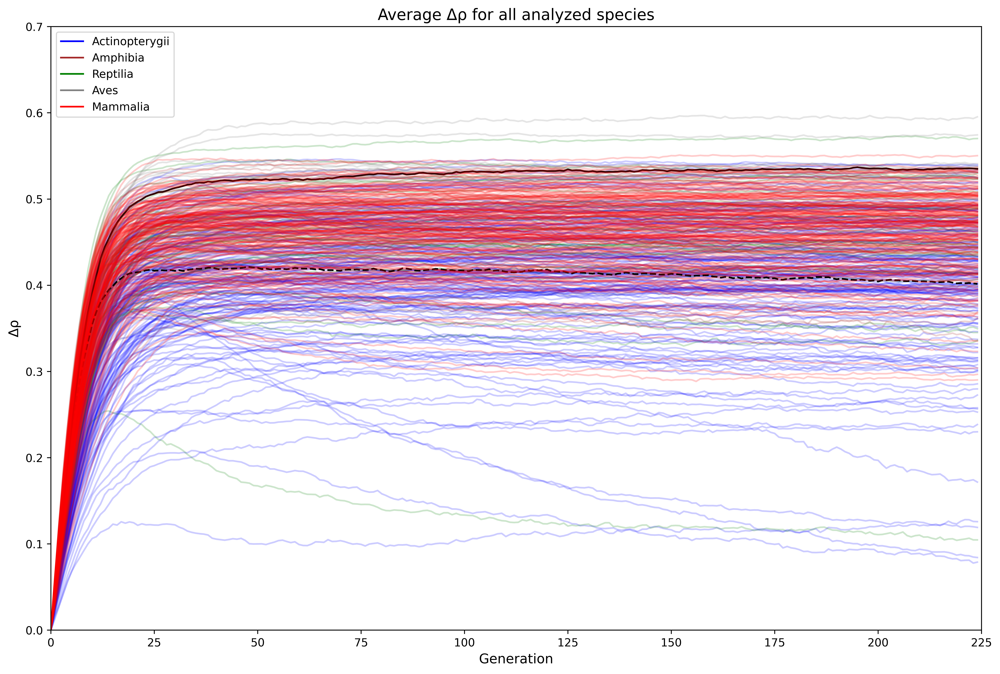

387


In [165]:
plt.figure(figsize=(15, 10), dpi=600)
species_counter = 0
for Class in class_list:
    line_colors = ['blue', 'brown', 'green', 'gray', 'red']
    class_labels = 1
    for species in cs_all[(cs_all.Class == Class) & (cs_all.Species.isin(sim_AllGenes_Shift))].Species.values:
        if species == 'Mus_musculus':
            plt.plot(deltaRho_ShiftMean[species], color='black') # , label=species
        if species == 'Loxodonta_africana':
            plt.plot(deltaRho_ShiftMean[species],  '--', color='black')    
        if species in zero_4:
            plt.plot(deltaRho_ShiftMean[species], alpha=0.2, color=line_colors[class_list.index(Class)]) # , label = Class
            species_counter+=1
        if class_labels == 1: # adding legend
            plt.plot(0, color=line_colors[class_list.index(Class)], label=Class)
            class_labels = 0

plt.xlim(0, 225)
plt.ylim(0, 0.7)
plt.xlabel('Generation', fontsize=12)
plt.ylabel('Δρ', fontsize=12)
plt.title('Average Δρ for all analyzed species', fontsize=14)
plt.legend(loc='upper left', fontsize=10)
plt.savefig('Course work pictures\\Results_graphs\\Δρ + mouse&elephant.pdf')
plt.show()
# class_list = ['Actinopterygii', 'Amphibia', 'Reptilia', 'Aves', 'Mammalia']

print(species_counter)

# Евклидово расстояние

In [4]:
species_list = random.choices(sim_AllGenes_Shift, k=10)
for species in species_list:
    euc_dict_mean = {aa:np.array([0 for i in range(225)]) for aa in aa_dict}
    for sample in range(20):
        # plt.figure(figsize=(15, 10), dpi=600)
        codons_freq = pd.read_csv(f'Practice\\Results_AllGenes_shift\\{species}\\{sample}\\Frequencies.csv', sep='\t').copy()
        for aa in aa_dict:
            if aa == '_': continue
            euc_list = [] # vector of generated values of Euc dist for every gen
            for gen in range(1,226): # zero gen is a live genome
                vec_0 = codons_freq[aa_dict[aa]].iloc[0]
                vec_gen = codons_freq[aa_dict[aa]].iloc[gen]
                euc_dist = distance.euclidean(vec_0, vec_gen)
                euc_list.append(euc_dist)
            euc_dict_mean[aa] = euc_dict_mean[aa] + euc_list
        #     if len(aa_dict[aa]) == 4:
        #         plt.plot(euc_list, '--', alpha=0.5, label=aa)
        #     else: plt.plot(euc_list, alpha=0.5, label=aa)
        # plt.xlim(0, 225)
        # plt.ylim(top=0.12)
        # plt.xlabel('Поколение')
        # plt.ylabel('Евклидово расстояние')
        # plt.title(f'Евклидово расстояние для {species}, sample:{sample+1}')
        # plt.legend(loc='upper left', ncol = 5)
        # os.makedirs(f'Practice\\Results_graphs\\Euclidean metric\\{species}', exist_ok=True)
        # plt.savefig(f'Practice\\Results_graphs\\Euclidean metric\\{species}\\{sample}.png')
        plt.show()
    for i in euc_dict_mean:
        euc_dict_mean[i] = euc_dict_mean[i] / 20

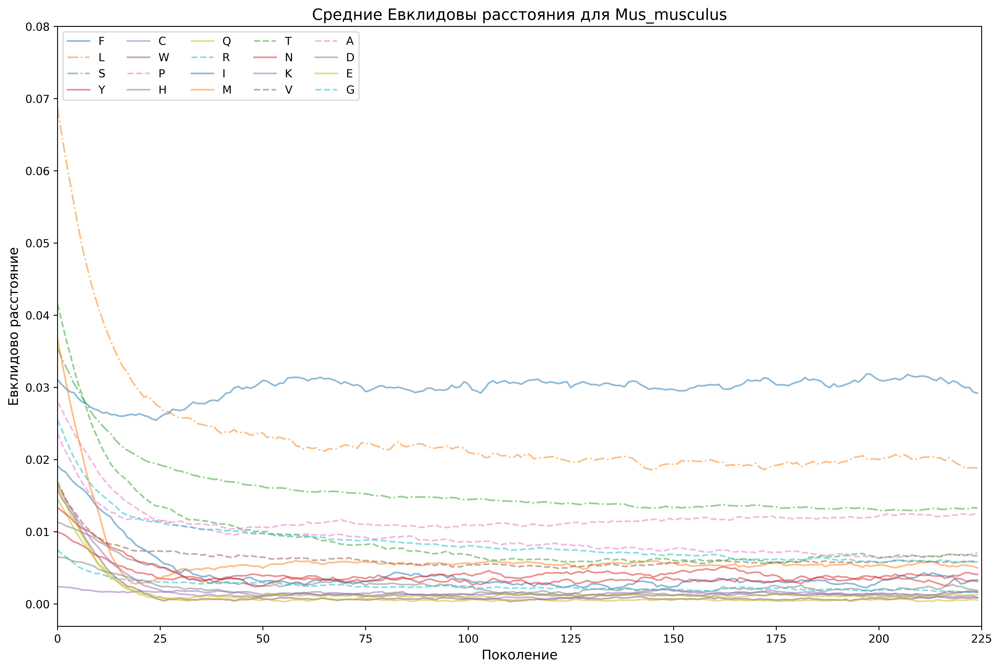

In [5]:
for species in species_list:
    plt.figure(figsize=(15, 10), dpi=600)
    for aa in aa_dict:
        if aa == '_': continue
        if len(aa_dict[aa]) == 4:
            plt.plot(euc_dict_mean[aa], '--', alpha=0.5, label=aa)
        elif len(aa_dict[aa]) == 2:
            plt.plot(euc_dict_mean[aa], '-', alpha=0.5, label=aa)
        else:
            plt.plot(euc_dict_mean[aa], '-.', alpha=0.5, label=aa)
    plt.xlim(0, 225)
    plt.ylim(top=0.08)
    plt.xlabel('Поколение')
    plt.ylabel('Евклидово расстояние')
    plt.title(f'Средние Евклидовы расстояния для {species}')
    plt.legend(loc='upper left', ncol = 5)
    os.makedirs(f'Course work pictures\\Results_graphs\\Euclidean metric\\{species}', exist_ok=True)
    plt.savefig(f'Course work pictures\\Results_graphs\\Euclidean metric\\{species}\\Average.png')
    plt.show()

# Средний мутспек

0.9999999999999999


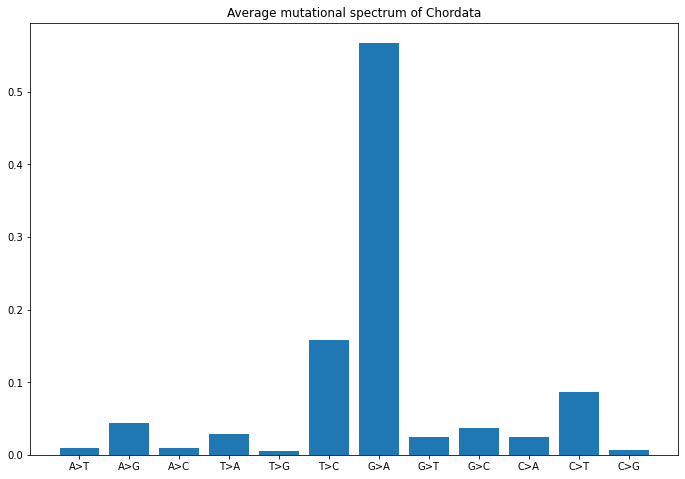

In [3]:
vals = list(ms[ms.Species.isin(zero_6)].loc[:,'A_T':'C_G'].mean())
print(sum(vals))

subs = [sub.replace('_', '>') for sub in ms.columns.tolist()[1:]]#['T>A', 'T>C', 'T>G', 'A>T', 'A>C', 'A>G', 'C>T', 'C>A', 'C>G', 'G>T', 'G>A', 'G>C']
# for i in range(len(subs)):
#     subs[i] = str(Seq(subs[i]).complement())

subs[-1], subs[-2] = subs[-2], subs[-1] # изменяет последовательность, чтобы текст не накладывался
vals[-1], vals[-2] = vals[-2], vals[-1]

fig = plt.figure(figsize=(9, 6))
ax = fig.add_axes([0,0,1,1])
ax.bar(subs,vals)
# ax.set_ylabel()
ax.set_title('Average mutational spectrum of Chordata')
# plt.savefig('Course work pictures\\Results_graphs\\ms.png',bbox_inches='tight')
plt.show()

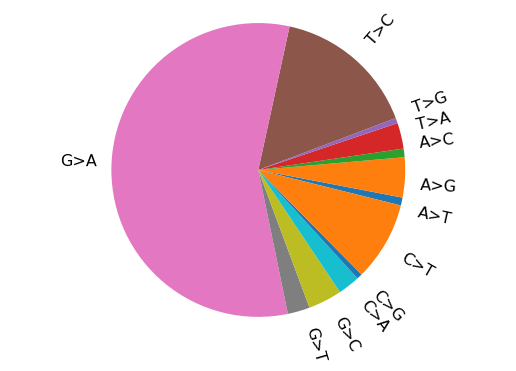

In [16]:
fig, ax = plt.subplots(figsize=(9, 6))
ax.pie(vals, labels=subs, rotatelabels=True, startangle=-14, textprops={'fontsize': 16}) # , textprops={'fontsize': 18}
ax.axis("equal")
# plt.title('MutSpec Mus Musculus')
plt.savefig('Practice\\Pie plot.png')
plt.show()

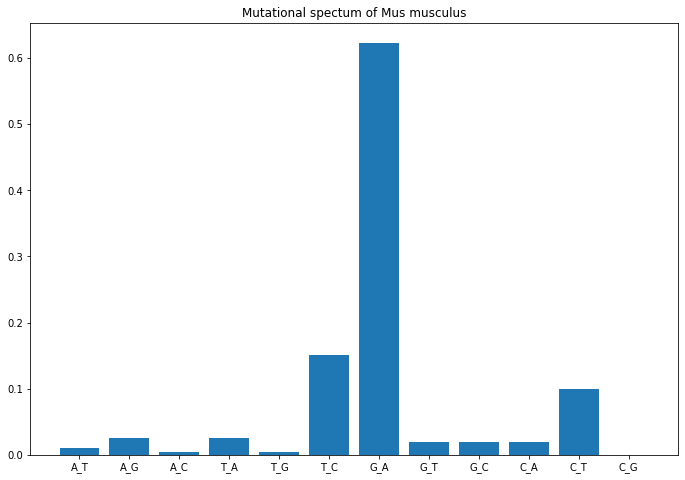

In [4]:
vals = ms[ms.Species=='Mus_musculus'].iloc[0].tolist()[1:]

subs = ms.columns.tolist()[1:]#['T>A', 'T>C', 'T>G', 'A>T', 'A>C', 'A>G', 'C>T', 'C>A', 'C>G', 'G>T', 'G>A', 'G>C']
# for i in range(len(subs)):
#     subs[i] = str(Seq(subs[i]).complement())
fig = plt.figure(figsize=(9, 6))
ax = fig.add_axes([0,0,1,1])
ax.bar(subs,vals)
# ax.set_ylabel()
ax.set_title('Mutational spectum of Mus musculus')
plt.savefig('Course work pictures\\Results_graphs\\msMus_musculus.png', bbox_inches='tight')
plt.show()

In [21]:
ms[ms.Species=='Mus_musculus'].iloc[0].tolist()[1:]

[0.009729343096403,
 0.0248824899808707,
 0.005125777714604,
 0.0248709965673907,
 0.0040051223125168,
 0.150563187115621,
 0.621941763900787,
 0.0195909041463318,
 0.0201832487681848,
 0.0193918303795617,
 0.0992358068925552,
 0.0004795291251737]

# Хитмап

In [113]:
cu = pd.read_csv('Practice/CodonFrequencyAllGenes.csv', sep='\t').copy()
cu[cu.Species=='Mus_musculus']

,Species,AAA,AAC,AAG,AAT,ACA,ACC,ACG,ACT,AGA,...,TCG,TCT,TGA,TGC,TGG,TGT,TTA,TTC,TTG,TTT
2193,Mus_musculus,0.027939,0.029599,0.000277,0.015491,0.04343,0.02379,0.001383,0.014938,0.0,...,0.00083,0.011065,0.025726,0.004979,0.001383,0.00166,0.031535,0.036791,0.001936,0.027109


In [137]:
mus_cu = {c:val for c, val in zip(cu.columns.to_list()[1:], cu[cu.Species=='Mus_musculus'].values[0][1:])}    
for aa in aa_dict:
    if aa == '_': continue
    mus_aa = 0
    for c in aa_dict[aa]:
        mus_aa += mus_cu[c]
    for c in aa_dict[aa]:
        mus_cu[c] = mus_cu[c]/mus_aa
for aa in aa_dict:
    for c in aa_dict[aa]:
        print(str(c) + ' ' + str(mus_cu[c]))

TTT 0.4242424242424238
TTC 0.575757575757576
TTA 0.20284697508896787
TTG 0.012455516014234695
CTT 0.14946619217081827
CTC 0.11387900355871897
CTA 0.47330960854092613
CTG 0.04804270462633401
TCT 0.14234875444839903
TCC 0.1672597864768685
TCA 0.5160142348754463
TCG 0.010676156583628674
AGT 0.03914590747330899
AGC 0.12455516014234866
TAT 0.4827586206896556
TAC 0.5172413793103444
TGT 0.24999999999999248
TGC 0.7500000000000075
TGA 0.9489795918367367
TGG 0.05102040816326316
CCT 0.1450777202072539
CCC 0.17616580310880842
CCA 0.6683937823834207
CCG 0.010362694300516931
CAT 0.3505154639175263
CAC 0.6494845360824738
CAA 0.9629629629629671
CAG 0.03703703703703291
CGT 0.12698412698412537
CGC 0.2857142857142849
CGA 0.5396825396825471
CGG 0.04761904761904271
ATT 0.6162464985994397
ATC 0.3837535014005603
ATA 0.9025423728813567
ATG 0.09745762711864331
ACT 0.1788079470198671
ACC 0.2847682119205302
ACA 0.5198675496688747
ACG 0.01655629139072775
AAT 0.34355828220858853
AAC 0.6564417177914116
AAA 0.990196

In [164]:
c_order = ['TTT', 'TCT', 'TAT', 'TGT', 'TTC', 'TCC', 'TAC', 'TGC', 'TTA', 'TCA', 'TAA', 'TGA', 'TTG', 'TCG', 'TAG', 'TGG', 'CTT', 'CCT', 'CAT', 'CGT', 'CTC', 'CCC', 'CAC', 'CGC', 'CTA', 'CCA', 'CAA', 'CGA', 'CTG', 'CCG', 'CAG', 'CGG', 'ATT', 'ACT', 'AAT', 'AGT', 'ATC', 'ACC', 'AAC', 'AGC', 'ATA', 'ACA', 'AAA', 'AGA', 'ATG', 'ACG', 'AAG', 'AGG', 'GTT', 'GCT', 'GAT', 'GGT', 'GTC', 'GCC', 'GAC', 'GGC', 'GTA', 'GCA', 'GAA', 'GGA', 'GTG', 'GCG', 'GAG', 'GGG']
val_order = []
one_raw = []
for c in c_order:
    one_raw.append(mus_cu[c])
    if len(one_raw) == 4:
        val_order.append(one_raw)
        one_raw = []
print(val_order)
print(c_order)

[[0.4242424242424238, 0.14234875444839903, 0.4827586206896556, 0.24999999999999248], [0.575757575757576, 0.1672597864768685, 0.5172413793103444, 0.7500000000000075], [0.20284697508896787, 0.5160142348754463, 0.0, 0.9489795918367367], [0.012455516014234695, 0.010676156583628674, 0.0, 0.05102040816326316], [0.14946619217081827, 0.1450777202072539, 0.3505154639175263, 0.12698412698412537], [0.11387900355871897, 0.17616580310880842, 0.6494845360824738, 0.2857142857142849], [0.47330960854092613, 0.6683937823834207, 0.9629629629629671, 0.5396825396825471], [0.04804270462633401, 0.010362694300516931, 0.03703703703703291, 0.04761904761904271], [0.6162464985994397, 0.1788079470198671, 0.34355828220858853, 0.03914590747330899], [0.3837535014005603, 0.2847682119205302, 0.6564417177914116, 0.12455516014234866], [0.9025423728813567, 0.5198675496688747, 0.9901960784313737, 0.0], [0.09745762711864331, 0.01655629139072775, 0.009803921568626304, 0.0], [0.2585034013605445, 0.1911111111111112, 0.36764705

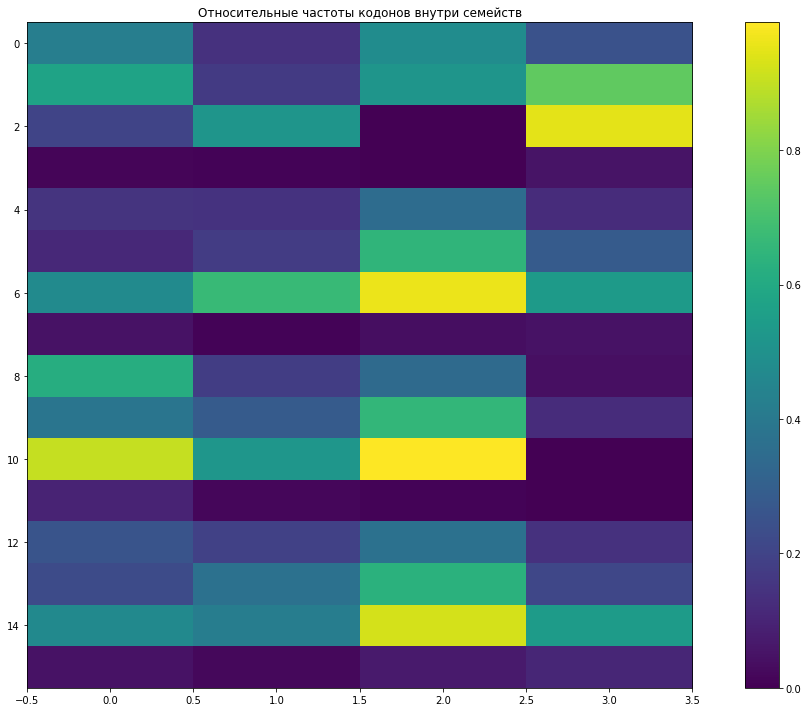

In [163]:
vegetables = ["cucumber", "tomato", "lettuce", "asparagus",
              "potato", "wheat", "barley"]
farmers = ["Farmer Joe", "Upland Bros.", "Smith Gardening",
           "Agrifun", "Organiculture", "BioGoods Ltd.", "Cornylee Corp."]

harvest = np.array(val_order)


fig, ax = plt.subplots(figsize=(15, 10))
im = ax.imshow(harvest)

# Show all ticks and label them with the respective list entries
# ax.set_xticks(np.arange(4)) #, labels=farmers
# ax.set_yticks(np.arange(4))



# Loop over data dimensions and create text annotations.
# for i in range(len(vegetables)):
#     for j in range(len(farmers)):
#         text = ax.text(j, i, harvest[i, j],
#                        ha="center", va="center", color="w")
cbar = ax.figure.colorbar(im, ax=ax)
cbar.ax.set_ylabel('', rotation=-90, va="bottom")

ax.set_title("Относительные частоты кодонов внутри семейств")
ax.set_aspect(aspect=0.25)
fig.tight_layout()
plt.savefig('Course work pictures\\Results_graphs\\hm.png') #,bbox_inches='tight'
plt.show()

# Ecology

## Холодно- и теплокровные

In [6]:
Class_dict = {}
for Class in class_list:
    Class_dict[Class] = cs_all[(cs_all.Class == Class) & (cs_all.Species.isin(zero_4))].Species.values # sim_AllGenes_Shift
    
cold_blood = list(Class_dict['Actinopterygii']) + list(Class_dict['Amphibia'])
warm_blood = list(Class_dict['Aves']) + list(Class_dict['Mammalia'])
сold_blood_pseudo = list(Class_dict['Actinopterygii']) + list(Class_dict['Amphibia']) + list(Class_dict['Reptilia'])
# print(MW(cold_blood, warm_blood))

gen = 225

warm_cold_dict = {'cold-blood':[], 'warm-blood':[]}
for species in cold_blood:
    warm_cold_dict['cold-blood'].append(deltaRho_ShiftMean[species][gen-1])
for species in warm_blood:
    warm_cold_dict['warm-blood'].append(deltaRho_ShiftMean[species][gen-1])

print('Cold: {}'.format(len(warm_cold_dict['cold-blood'])))
print('Warm: {}'.format(len(warm_cold_dict['warm-blood'])))

Cold: 164
Warm: 191


In [41]:
Class_dict = {}
for Class in class_list:
    Class_dict[Class] = cs_all[(cs_all.Class == Class) & (cs_all.Species.isin(zero_4))].Species.values # sim_AllGenes_Shift
    
cold_blood = list(Class_dict['Actinopterygii']) + list(Class_dict['Amphibia'])
warm_blood = list(Class_dict['Aves']) + list(Class_dict['Mammalia'])
сold_blood_pseudo = list(Class_dict['Actinopterygii']) + list(Class_dict['Amphibia']) + list(Class_dict['Reptilia'])
print(warm_blood)

['Agelaius_phoeniceus', 'Alauda_arvensis', 'Alectoris_chukar', 'Anas_platyrhynchos', 'Anser_cygnoides', 'Bambusicola_thoracicus', 'Brotogeris_cyanoptera', 'Cardinalis_cardinalis', 'Carpodacus_erythrinus', 'Copsychus_saularis', 'Cyanopica_cyanus', 'Eopsaltria_australis', 'Eopsaltria_griseogularis', 'Fringilla_coelebs', 'Gallus_gallus', 'Garrulax_canorus', 'Garrulus_glandarius', 'Grus_canadensis', 'Henicorhina_leucosticta', 'Acomys_cahirinus', 'Ailuropoda_melanoleuca', 'Alouatta_seniculus', 'Anourosorex_squamipes', 'Aotus_nancymaae', 'Apodemus_draco', 'Apodemus_latronum', 'Apodemus_peninsulae', 'Arctocephalus_forsteri', 'Artibeus_jamaicensis', 'Artibeus_lituratus', 'Ateles_belzebuth', 'Avahi_laniger', 'Balaena_mysticetus', 'Bandicota_indica', 'Bos_indicus', 'Bos_javanicus', 'Bos_taurus', 'Bubalus_bubalis', 'Callosciurus_erythraeus', 'Canis_lupus', 'Canis_lupus_familiaris', 'Capra_aegagrus', 'Capreolus_capreolus', 'Capreolus_pygargus', 'Carollia_perspicillata', 'Cavia_porcellus', 'Cercopi

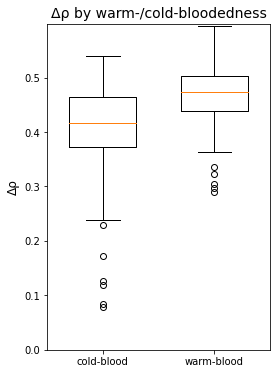

MannwhitneyuResult(statistic=8205.0, pvalue=1.0337820052776077e-14)


In [7]:
fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(warm_cold_dict.values(), widths=0.6)
ax.set_xticklabels(warm_cold_dict.keys())
plt.title('Δρ by warm-/cold-bloodedness', fontsize=14)
# plt.xlabel('Class', fontsize=12)
plt.ylabel('Δρ', fontsize=12)
plt.ylim(bottom=0, top=0.599)
# plt.savefig('Course work pictures\\Results_graphs\\Δρ CW-blood.png')
plt.show()

print(MW(warm_cold_dict['cold-blood'], warm_cold_dict['warm-blood']))
# print(spearmanr(warm_cold_dict['cold-blood'], warm_cold_dict['warm-blood'])) # the arrays must be the same size

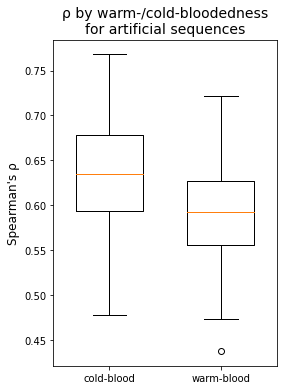

MannwhitneyuResult(statistic=21841.0, pvalue=1.461968197067895e-10)


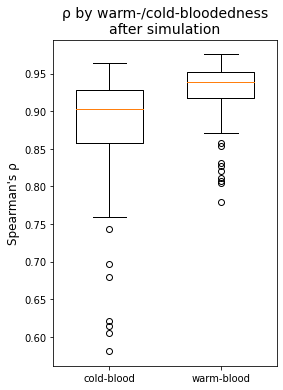

MannwhitneyuResult(statistic=7049.0, pvalue=4.1009054370708397e-19)


In [16]:
gen = 1

warm_cold_dict = {'cold-blood':[], 'warm-blood':[]}
for species in cold_blood:
    spearman_mean = pd.read_csv('Practice\\Results_AllGenes_shift\{}\SpearmanMean.csv'.format(species), sep='\t').copy()
    warm_cold_dict['cold-blood'].append(spearman_mean.spearman[gen-1])
for species in warm_blood:
    spearman_mean = pd.read_csv('Practice\\Results_AllGenes_shift\{}\SpearmanMean.csv'.format(species), sep='\t').copy()
    warm_cold_dict['warm-blood'].append(spearman_mean.spearman[gen-1])
    
fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(warm_cold_dict.values(), widths=0.6)
ax.set_xticklabels(warm_cold_dict.keys())
plt.title('ρ by warm-/cold-bloodedness\nfor artificial sequences', fontsize=14)
# plt.xlabel('Class', fontsize=12)
plt.ylabel('Spearman\'s ρ', fontsize=12)
# plt.savefig('Course work pictures\\Results_graphs\\Δρ CW-blood.png')
plt.show()

print(MW(warm_cold_dict['cold-blood'], warm_cold_dict['warm-blood']))

gen = 225

warm_cold_dict = {'cold-blood':[], 'warm-blood':[]}
for species in cold_blood:
    spearman_mean = pd.read_csv('Practice\\Results_AllGenes_shift\{}\SpearmanMean.csv'.format(species), sep='\t').copy()
    warm_cold_dict['cold-blood'].append(spearman_mean.spearman[gen-1])
for species in warm_blood:
    spearman_mean = pd.read_csv('Practice\\Results_AllGenes_shift\{}\SpearmanMean.csv'.format(species), sep='\t').copy()
    warm_cold_dict['warm-blood'].append(spearman_mean.spearman[gen-1])
    
fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(warm_cold_dict.values(), widths=0.6)
ax.set_xticklabels(warm_cold_dict.keys())
plt.title('ρ by warm-/cold-bloodedness\nafter simulation', fontsize=14)
# plt.xlabel('Class', fontsize=12)
plt.ylabel('Spearman\'s ρ', fontsize=12)
# plt.savefig('Course work pictures\\Results_graphs\\Δρ CW-blood.png')
plt.show()

print(MW(warm_cold_dict['cold-blood'], warm_cold_dict['warm-blood']))

In [5]:
# reverse mutspec for warm- and coldblooded
warm_blooded = ['Agelaius_phoeniceus', 'Alauda_arvensis', 'Alectoris_chukar', 'Anas_platyrhynchos', 'Anser_cygnoides', 'Bambusicola_thoracicus', 'Brotogeris_cyanoptera', 'Cardinalis_cardinalis', 'Carpodacus_erythrinus', 'Copsychus_saularis', 'Cyanopica_cyanus', 'Eopsaltria_australis', 'Eopsaltria_griseogularis', 'Fringilla_coelebs', 'Gallus_gallus', 'Garrulax_canorus', 'Garrulus_glandarius', 'Grus_canadensis', 'Henicorhina_leucosticta', 'Acomys_cahirinus', 'Ailuropoda_melanoleuca', 'Alouatta_seniculus', 'Anourosorex_squamipes', 'Aotus_nancymaae', 'Apodemus_draco', 'Apodemus_latronum', 'Apodemus_peninsulae', 'Arctocephalus_forsteri', 'Artibeus_jamaicensis', 'Artibeus_lituratus', 'Ateles_belzebuth', 'Avahi_laniger', 'Balaena_mysticetus', 'Bandicota_indica', 'Bos_indicus', 'Bos_javanicus', 'Bos_taurus', 'Bubalus_bubalis', 'Callosciurus_erythraeus', 'Canis_lupus', 'Canis_lupus_familiaris', 'Capra_aegagrus', 'Capreolus_capreolus', 'Capreolus_pygargus', 'Carollia_perspicillata', 'Cavia_porcellus', 'Cercopithecus_albogularis', 'Cercopithecus_mitis', 'Cervus_elaphus', 'Cheirogaleus_medius', 'Chlorocebus_cynosuros', 'Chlorocebus_pygerythrus', 'Chlorocebus_tantalus', 'Colobus_guereza', 'Cricetulus_kamensis', 'Crocidura_attenuata', 'Crocidura_beatus', 'Crocidura_grayi', 'Crocidura_mindorus', 'Crocidura_russula', 'Crocidura_shantungensis', 'Cynomys_ludovicianus', 'Cynopterus_brachyotis', 'Dasypus_novemcinctus', 'Dasyurus_hallucatus', 'Daubentonia_madagascariensis', 'Desmodus_rotundus', 'Dremomys_rufigenis', 'Eospalax_baileyi', 'Eospalax_cansus', 'Eothenomys_chinensis', 'Eothenomys_melanogaster', 'Eothenomys_miletus', 'Eozapus_setchuanus', 'Episoriculus_caudatus', 'Episoriculus_fumidus', 'Episoriculus_macrurus', 'Epomophorus_gambianus', 'Equus_asinus', 'Equus_caballus', 'Euchoreutes_naso', 'Gazella_subgutturosa', 'Gorilla_gorilla', 'Gorilla_gorilla_gorilla', 'Herpestes_javanicus', 'Heterocephalus_glaber', 'Hipposideros_armiger', 'Hylobates_agilis', 'Hylobates_lar', 'Hylomys_suillus', 'Indri_indri', 'Lama_guanicoe', 'Laonastes_aenigmamus', 'Lasiurus_borealis', 'Leopoldamys_edwardsi', 'Lepilemur_ruficaudatus', 'Lepus_americanus', 'Lepus_capensis', 'Lepus_europaeus', 'Lepus_sinensis', 'Lepus_timidus', 'Lophostoma_silvicolum', 'Loris_tardigradus', 'Macaca_fascicularis', 'Macaca_mulatta', 'Macaca_nemestrina', 'Macaca_tonkeana', 'Martes_flavigula', 'Martes_zibellina', 'Meles_meles', 'Meriones_libycus', 'Meriones_meridianus', 'Microcebus_murinus', 'Micromys_minutus', 'Micronycteris_megalotis', 'Mogera_wogura', 'Monodelphis_domestica', 'Mustela_frenata', 'Mustela_nivalis', 'Mustela_sibirica', 'Mus_caroli', 'Mus_musculus', 'Myodes_glareolus', 'Myodes_rufocanus', 'Myotis_davidii', 'Myotis_lucifugus', 'Myotis_muricola', 'Nasua_nasua', 'Neodon_irene', 'Neomys_fodiens', 'Neotetracus_sinensis', 'Niviventer_confucianus', 'Niviventer_excelsior', 'Niviventer_fulvescens', 'Nyctalus_noctula', 'Nycticebus_coucang', 'Ochotona_collaris', 'Ochotona_curzoniae', 'Ochotona_princeps', 'Ornithorhynchus_anatinus', 'Ovis_ammon', 'Pan_troglodytes', 'Papio_anubis', 'Papio_cynocephalus', 'Pecari_tajacu', 'Perameles_gunnii', 'Perodicticus_potto', 'Petaurista_alborufus', 'Plecotus_auritus', 'Plecotus_macrobullaris', 'Potorous_tridactylus', 'Presbytis_melalophos', 'Prionailurus_viverrinus', 'Procyon_lotor', 'Propithecus_diadema', 'Propithecus_edwardsi', 'Propithecus_verreauxi', 'Pseudois_nayaur', 'Pteromys_volans', 'Pteronotus_parnellii', 'Rangifer_tarandus', 'Rattus_rattus', 'Rattus_tanezumi', 'Rattus_tiomanicus', 'Rhinolophus_macrotis', 'Rhinopithecus_bieti', 'Rousettus_aegyptiacus', 'Semnopithecus_entellus', 'Sorex_araneus', 'Sorex_cylindricauda', 'Sorex_unguiculatus', 'Suncus_murinus', 'Sus_celebensis', 'Sus_scrofa', 'Symphalangus_syndactylus', 'Tamias_sibiricus', 'Tamiops_maritimus', 'Tamiops_swinhoei', 'Thylamys_elegans', 'Trachypithecus_francoisi', 'Tragelaphus_scriptus', 'Tupaia_belangeri', 'Tursiops_aduncus', 'Tursiops_truncatus', 'Urocyon_cinereoargenteus', 'Urotrichus_talpoides', 'Ursus_arctos', 'Ursus_thibetanus', 'Vicugna_vicugna', 'Viverricula_indica', 'Vulpes_vulpes']
cold_blooded = ['Abbottina_rivularis', 'Abudefduf_vaigiensis', 'Acanthogobius_hasta', 'Acanthopagrus_schlegelii', 'Acanthorhodeus_chankaensis', 'Acheilognathus_barbatus', 'Acheilognathus_macropterus', 'Acheilognathus_signifer', 'Acheilognathus_somjinensis', 'Acipenser_gueldenstaedtii', 'Acipenser_schrenckii', 'Acrossocheilus_parallens', 'Acrossocheilus_yunnanensis', 'Agonostomus_monticola', 'Alburnus_alburnus', 'Amphiprion_clarkii', 'Amphiprion_ocellaris', 'Amphiprion_percula', 'Anabas_testudineus', 'Anguilla_anguilla', 'Anguilla_bicolor_bicolor', 'Anguilla_marmorata', 'Apteronotus_albifrons', 'Auxis_rochei', 'Auxis_thazard', 'Barbatula_barbatula', 'Barbatula_nuda', 'Barbatula_toni', 'Beaufortia_kweichowensis', 'Beryx_splendens', 'Biwia_zezera', 'Boleophthalmus_pectinirostris', 'Brachyhypopomus_occidentalis', 'Brachymystax_lenok', 'Campostoma_anomalum', 'Carassius_auratus', 'Carassius_auratus_auratus', 'Carassius_carassius', 'Carassius_cuvieri', 'Carassius_gibelio', 'Catla_catla', 'Channa_argus', 'Channa_asiatica', 'Channa_maculata', 'Chuanchia_labiosa', 'Cirrhinus_mrigala', 'Clarias_gariepinus', 'Cleisthenes_herzensteini', 'Clupea_harengus', 'Clupea_pallasii', 'Cobitis_biwae', 'Cobitis_sinensis', 'Cobitis_striata', 'Coilia_mystus', 'Colomesus_asellus', 'Coregonus_lavaretus', 'Coregonus_muksun', 'Coregonus_oxyrinchus', 'Coreoleuciscus_splendidus', 'Coreoperca_kawamebari', 'Cottus_bairdii', 'Ctenopharyngodon_idella', 'Culter_alburnus', 'Cyprinella_lutrensis', 'Cyprinodon_rubrofluviatilis', 'Cyprinodon_variegatus', 'Cyprinus_carpio', 'Cyprinus_multitaeniata', 'Danio_rerio', 'Dicentrarchus_labrax', 'Dicentrarchus_punctatus', 'Diplomystes_nahuelbutaensis', 'Diptychus_maculatus', 'Elassoma_evergladei', 'Elassoma_zonatum', 'Eleutheronema_tetradactylum', 'Elopichthys_bambusa', 'Engraulis_encrasicolus', 'Epinephelus_akaara', 'Epinephelus_fuscoguttatus', 'Epinephelus_lanceolatus', 'Erpetoichthys_calabaricus', 'Esox_lucius', 'Euchiloglanis_kishinouyei', 'Exocoetus_volitans', 'Fundulus_heteroclitus', 'Fundulus_notatus', 'Fundulus_olivaceus', 'Gadus_chalcogrammus', 'Gadus_morhua', 'Galaxias_maculatus', 'Galaxias_truttaceus', 'Garra_orientalis', 'Glyptothorax_zanaensis', 'Gobiobotia_brevibarba', 'Gobiobotia_macrocephala', 'Gobiobotia_naktongensis', 'Gobio_gobio', 'Gymnocypris_eckloni', 'Gymnocypris_przewalskii', 'Gymnodiptychus_dybowskii', 'Gymnodiptychus_pachycheilus', 'Hemibagrus_guttatus', 'Hemibagrus_macropterus', 'Heteropneustes_fossilis', 'Hippocampus_ingens', 'Hypophthalmichthys_molitrix', 'Hypophthalmichthys_nobilis', 'Katsuwonus_pelamis', 'Larimichthys_polyactis', 'Lepomis_macrochirus', 'Lota_lota', 'Lutjanus_argentimaculatus', 'Micromesistius_poutassou', 'Micropterus_dolomieu', 'Micropterus_salmoides', 'Mugil_cephalus', 'Mugil_curema', 'Oncorhynchus_keta', 'Oncorhynchus_mykiss', 'Oreochromis_niloticus', 'Oryzias_latipes', 'Osmerus_mordax', 'Pampus_argenteus', 'Panthera_leo', 'Paralichthys_olivaceus', 'Pellonula_leonensis', 'Perca_fluviatilis', 'Phoxinus_phoxinus', 'Platichthys_stellatus', 'Plectropomus_leopardus', 'Plotosus_lineatus', 'Poecilia_reticulata', 'Pollachius_virens', 'Pseudopleuronectes_yokohamae', 'Pungitius_pungitius', 'Rastrelliger_kanagurta', 'Reinhardtius_hippoglossoides', 'Salmo_salar', 'Salmo_trutta', 'Scomberomorus_munroi', 'Scomberomorus_semifasciatus', 'Scomber_japonicus', 'Seriola_dumerili', 'Siganus_canaliculatus', 'Spicara_maena', 'Sprattus_sprattus', 'Squaliobarbus_curriculus', 'Takifugu_rubripes', 'Terapon_jarbua', 'Thunnus_alalunga', 'Thunnus_thynnus', 'Tropheus_moorii', 'Xiphias_gladius', 'Zeus_faber', 'Andrias_davidianus', 'Batrachuperus_pinchonii', 'Bombina_maxima', 'Bombina_variegata', 'Desmognathus_fuscus', 'Desmognathus_wrighti', 'Duttaphrynus_melanostictus', 'Echinotriton_andersoni', 'Gyrinophilus_porphyriticus']

deltaRho_ShiftMean_CWR = {}
for species in warm_blooded+cold_blooded:
    deltaRho_Shift = {}
    deltaRho_ShiftMean_CWR[species] = np.array([0 for i in range(225)])
    for sample in range(20):
        spearman = pd.read_csv('Practice\\Results_AllGenes_shift_ColdWarmReverse\{}\{}\Spearman.csv'.format(species, sample), sep='\t').copy()
        deltaRho_Shift[sample] = []

        for spearman_value in spearman.spearman.values:
            deltaRho_Shift[sample].append(spearman_value - spearman.spearman.values[0])
        deltaRho_ShiftMean_CWR[species] = deltaRho_ShiftMean_CWR[species] + deltaRho_Shift[sample]
    deltaRho_ShiftMean_CWR[species] = deltaRho_ShiftMean_CWR[species]/20

In [8]:
gen = 225

warm_cold_dict_CWR = {'cold-blood':[], 'warm-blood':[]}
for species in cold_blood:
    warm_cold_dict_CWR['cold-blood'].append(deltaRho_ShiftMean_CWR[species][gen-1])
for species in warm_blood:
    warm_cold_dict_CWR['warm-blood'].append(deltaRho_ShiftMean_CWR[species][gen-1])

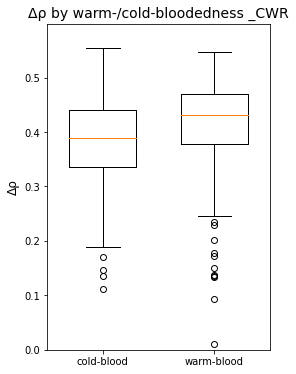

MannwhitneyuResult(statistic=12008.0, pvalue=0.00015066359682503911)


In [17]:
fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(warm_cold_dict_CWR.values(), widths=0.6)
ax.set_xticklabels(warm_cold_dict_CWR.keys())
plt.title('Δρ by warm-/cold-bloodedness _CWR', fontsize=14)
# plt.xlabel('Class', fontsize=12)
plt.ylabel('Δρ', fontsize=12)
plt.ylim(bottom=0, top=0.599)
plt.savefig('Course work pictures\\Results_graphs\\Δρ CW-blood_CWR.png')
plt.show()

print(MW(warm_cold_dict_CWR['cold-blood'], warm_cold_dict_CWR['warm-blood']))

## Generation lenght

In [8]:
gl = pd.read_csv('Practice/Generation_Lenght.csv', sep='\t').copy()
gl.head()
gl[gl.Scientific_name.isin(sim_AllGenes_Shift)].sort_values(by='GenerationLength_d')

,Genus,Scientific_name,AdultBodyMass_g,Sources_AdultBodyMass,Max_longevity_d,Sources_Max_longevity,Rspan_d,AFR_d,Data_AFR,Calculated_GL_d,GenerationLength_d,Sources_GL
15,Suncus,Suncus_murinus,43.76,PanTHERIA,1040.25,PanTHERIA;AnAge,1037.905,62.535,calculated,363.52745,363.527450,Rspan-AFR(SM+Gest)
825,Blarinella,Blarinella_quadraticauda,12.50,PanTHERIA,no information,no information,no information,no information,no information,no information,379.292956,Mean_family_same_body_mass
837,Anourosorex,Anourosorex_squamipes,20.00,PanTHERIA,no information,no information,no information,no information,no information,no information,379.292956,Mean_family_same_body_mass
846,Nectogale,Nectogale_elegans,38.82,PanTHERIA,no information,no information,no information,no information,no information,no information,379.292956,Mean_family_same_body_mass
21,Sorex,Sorex_unguiculatus,14.11,PanTHERIA,547.5,PanTHERIA,297.23,306.27,calculated,392.4667,392.466700,Rspan-AFR(SM+Gest)
...,...,...,...,...,...,...,...,...,...,...,...,...
670,Stenella,Stenella_coeruleoalba,142102.96,PanTHERIA,19493.75,PanTHERIA; AnAge,16291.725,3202.025,calculated,7926.62525,7926.625250,Rspan-AFR(SM+Gest)
5419,Gorilla,Gorilla_gorilla,112589.00,PanTHERIA,19965.5,PanTHERIA;AnAge,16315.5,3650,PanTHERIA,8381.495,8030.000000,GMA
5056,Pan,Pan_paniscus,35119.95,PanTHERIA,18797.5,PanTHERIA;AnAge,no information,no information,no information,no information,9125.000000,GMA
5421,Loxodonta,Loxodonta_africana,3824540.00,PanTHERIA,27375,PanTHERIA;AnAge;Carn_Ung,23907.5,3467.5,PanTHERIA,10400.675,9125.000000,GMA


82


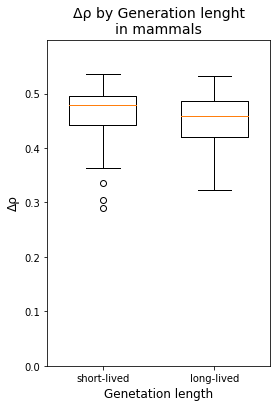

MannwhitneyuResult(statistic=3926.0, pvalue=0.06384976811820747)
SpearmanrResult(correlation=-0.11975272363165398, pvalue=0.2838901926522568)


In [9]:
q_dict_GL = {}
quartiles = 2
analysed_species = gl[(gl.Scientific_name.isin(zero_4))] # (gl.Scientific_name.isin(sim_AllGenes_Shift)
multipliier = len(analysed_species) // quartiles
for quartile in [quartile for quartile in range(quartiles)]:
    q_dict_GL[quartile+1] = analysed_species.sort_values(by='GenerationLength_d').Scientific_name.values[quartile*multipliier:(quartile+1)*multipliier]
# q_dict[1]

print(len(q_dict_GL[1]))


dRhoGL_dict = {}
gen = 225
for quartile in q_dict_GL:
    vals = [deltaRho_ShiftMean[species][gen-1] for species in q_dict_GL[quartile]]
    dRhoGL_dict[quartile] = vals

fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(dRhoGL_dict.values(), widths=0.6)
ax.set_xticklabels(['short-lived', 'long-lived']) # dRhoGL_dict.keys()
plt.title('Δρ by Generation lenght\nin mammals', fontsize=14)
plt.xlabel('Genetation length', fontsize=12) # \'s quartiles\nshort-lived -> long-lived
plt.ylabel('Δρ', fontsize=12)
plt.ylim(bottom=0, top=0.599)
# plt.savefig(f'Course work pictures\\Results_graphs\\gl_{quartiles}.png',bbox_inches='tight')
plt.show()

print(MW(dRhoGL_dict[1], dRhoGL_dict[quartiles]))
print(spearmanr(dRhoGL_dict[1], dRhoGL_dict[quartiles]))

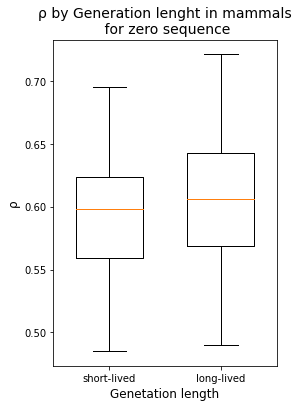

MannwhitneyuResult(statistic=2842.0, pvalue=0.08753969190560797)
SpearmanrResult(correlation=0.0734754737105604, pvalue=0.5118100286858995)


In [36]:
dRhoGL_dict = {}
gen = 1


for quartile in q_dict_GL:
    vals = [pd.read_csv('Practice\\Results_AllGenes_shift\{}\SpearmanMean.csv'.format(species), sep='\t').copy().spearman[gen-1] for species in q_dict_GL[quartile]]
    dRhoGL_dict[quartile] = vals

fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(dRhoGL_dict.values(), widths=0.6)
ax.set_xticklabels(['short-lived', 'long-lived']) # dRhoGL_dict.keys()
plt.title('ρ by Generation lenght in mammals\n for zero sequence', fontsize=14)
plt.xlabel('Genetation length', fontsize=12) # \'s quartiles\nshort-lived -> long-lived
plt.ylabel('ρ', fontsize=12)
# plt.ylim(bottom=0, top=0.599)
# plt.savefig(f'Course work pictures\\Results_graphs\\gl_{quartiles}.png',bbox_inches='tight')
plt.show()

print(MW(dRhoGL_dict[1], dRhoGL_dict[quartiles]))
print(spearmanr(dRhoGL_dict[1], dRhoGL_dict[quartiles]))

In [37]:
spGL_dict = {}
gen = 225
for quartile in q_dict_GL:
    vals = [spGL_dict[species][gen-1] for species in q_dict_GL[quartile]]
    spGL_dict[quartile] = vals

fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(spGL_dict.values(), widths=0.6)
ax.set_xticklabels(spGL_dict.keys()) # ['short-lived', 'long-lived']
plt.title('Spearman\'s ρ by Generation\nlenght in mammals', fontsize=14)
plt.xlabel('Generation length', fontsize=12)
plt.ylabel('Spearman\'s ρ', fontsize=12)
plt.ylim(bottom=0.6, top=0.999)
# plt.savefig(f'Course work pictures\\Results_graphs\\sp_gl_{quartiles}.png',bbox_inches='tight')
plt.show()

print(spearmanr(spGL_dict[1], spGL_dict[quartiles]))

KeyError: 'Suncus_murinus'

## Fish temperature

In [10]:
ft = pd.read_csv('Practice/FishTemperature.csv', sep=' ').copy()
ft[ft.Species.isin(sim_AllGenes_Shift)].groupby('Species').mean().sort_values(by='Temperature')

,Temperature
Species,
Osmerus_mordax,1.000000
Reinhardtius_hippoglossoides,2.333333
Lota_lota,3.100000
Hippoglossus_stenolepis,3.500000
Gadus_chalcogrammus,3.785714
...,...
Siganus_fuscescens,28.000000
Siganus_canaliculatus,28.225000
Hippocampus_reidi,28.500000


38


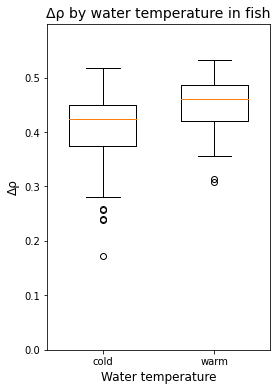

MannwhitneyuResult(statistic=454.0, pvalue=0.00545298512850621)
SpearmanrResult(correlation=0.04737936316883685, pvalue=0.777584582828455)


In [11]:
q_dict_FT = {}
quartiles = 2
analysed_species = ft[(ft.Species.isin(zero_4))].groupby('Species').mean() # (ft.Species.isin(sim_AllGenes_Shift)
multipliier = len(analysed_species) // quartiles
for quartile in [quartile for quartile in range(quartiles)]:
    q_dict_FT[quartile+1] = analysed_species.sort_values(by='Temperature').index.values[quartile*multipliier:(quartile+1)*multipliier]
# q_dict

print(len(q_dict_FT[1]))

dRhoFT_dict = {}
gen = 225
for quartile in q_dict_FT:
    vals = [deltaRho_ShiftMean[species][gen-1] for species in q_dict_FT[quartile]]
    dRhoFT_dict[quartile] = vals

fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(dRhoFT_dict.values(), widths=0.6)
ax.set_xticklabels(['cold', 'warm']) # ['cold', 'warm'] or dRhoFT_dict.keys()
plt.title('Δρ by water temperature in fish', fontsize=14)
plt.xlabel('Water temperature', fontsize=12) # cool -> warm
plt.ylabel('Δρ', fontsize=12)
plt.ylim(bottom=0, top=0.599)
# plt.savefig(f'Course work pictures\\Results_graphs\\ft_{quartiles}.png',bbox_inches='tight')
plt.show()

print(MW(dRhoFT_dict[1], dRhoFT_dict[quartiles]))
print(spearmanr(dRhoFT_dict[1], dRhoFT_dict[quartiles]))

In [44]:
sp_dict = {}
p_dict = {}
for species in sim_AllGenes_Shift:
    sp = pd.read_csv('Practice\Results_AllGenes_shift\{}\SpearmanMean.csv'.format(species), sep='\t').copy()
    sp_dict[species] = sp.pearson.values
    p_dict[species] = sp.spearman.values

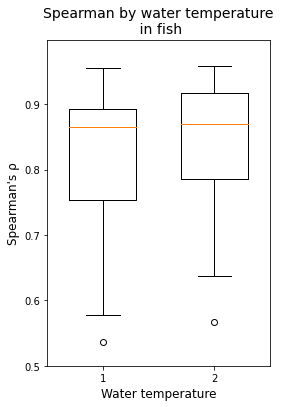

(-0.12418246433762539, 0.4056046353211045)
SpearmanrResult(correlation=-0.041049953746531, pvalue=0.7841140759947635)


In [201]:
spFT_dict = {}
gen = 225
for quartile in q_dict_FT:
    vals = [sp_dict[species][gen-1] for species in q_dict_FT[quartile]]
    spFT_dict[quartile] = vals

fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(spFT_dict.values(), widths=0.6)
ax.set_xticklabels(dRhoFT_dict.keys()) # ['cold', 'warm']
plt.title('Spearman by water temperature\n in fish', fontsize=14)
plt.xlabel('Water temperature', fontsize=12)
plt.ylabel('''Spearman's ρ''', fontsize=12)
plt.ylim(bottom=0.5, top=0.999)
plt.savefig(f'Course work pictures\\Results_graphs\\sp_ft_{quartiles}.png', bbox_inches='tight')
plt.show()

print(pearsonr(spFT_dict[1], spFT_dict[quartiles]))
print(spearmanr(spFT_dict[1], spFT_dict[quartiles]))

# Convergence time

In [5]:
# deltaRho_ShiftMean['Mus_musculus'].argmax() # a generation with the max value of deltaRho
deltaRho_ShiftMean_Time = {}
for species in sim_AllGenes_Shift:
    plateau = 0
    converge_gen = 0
    for i in range(len(deltaRho_ShiftMean[species])):
        deltaRho = deltaRho_ShiftMean[species][i]
        if deltaRho > plateau*1.1 :
            plateau = deltaRho
            converge_gen = i
    # converge_gen = np.where(deltaRho_ShiftMean[species] == plateau)[0][0] # np.where gives a tuple with an array within
    deltaRho_ShiftMean_Time[species] = converge_gen

## WC-blood

In [12]:
warm_cold_dict_T = {'cold-blood':[], 'warm-blood':[]}
for species in cold_blood:
    warm_cold_dict_T['cold-blood'].append(deltaRho_ShiftMean_Time[species])
for species in warm_blood:
    warm_cold_dict_T['warm-blood'].append(deltaRho_ShiftMean_Time[species])

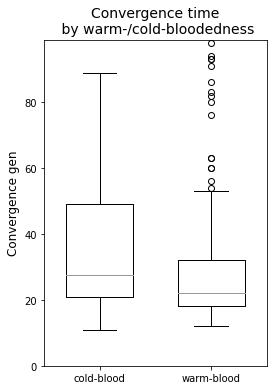

MannwhitneyuResult(statistic=19343.0, pvalue=0.00013284409520286606)


In [13]:
fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(warm_cold_dict_T.values(), widths=0.6)
ax.set_xticklabels(warm_cold_dict_T.keys())
plt.title('Convergence time\n by warm-/cold-bloodedness', fontsize=14)
# plt.xlabel('Class', fontsize=12)
plt.ylim(bottom=0, top=99)
plt.ylabel('Convergence gen', fontsize=12)
# plt.savefig('Course work pictures\\Results_graphs\\CT_WC-blood.png')
plt.show()

print(MW(warm_cold_dict_T['cold-blood'], warm_cold_dict_T['warm-blood']))

## GL

82


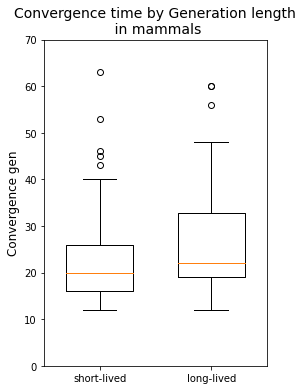

MannwhitneyuResult(statistic=2581.0, pvalue=0.010122970889136126)
SpearmanrResult(correlation=0.044242424766523715, pvalue=0.6930827017689598)


In [14]:
q_dict_GL = {}
quartiles = 2
analysed_species = gl[(gl.Scientific_name.isin(zero_4))] # (gl.Scientific_name.isin(sim_AllGenes_Shift)
multipliier = len(analysed_species) // quartiles
for quartile in [quartile for quartile in range(quartiles)]:
    q_dict_GL[quartile+1] = analysed_species.sort_values(by='GenerationLength_d').Scientific_name.values[quartile*multipliier:(quartile+1)*multipliier]
# q_dict[1]

print(len(q_dict_GL[1]))

dRhoGL_dict_T = {}
for quartile in q_dict_GL:
    vals = [deltaRho_ShiftMean_Time[species] for species in q_dict_GL[quartile]]
    dRhoGL_dict_T[quartile] = vals
# print(dRhoGL_dict_T)
    
fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(dRhoGL_dict_T.values(), widths=0.6)
ax.set_xticklabels(['short-lived', 'long-lived']) # dRhoGL_dict_T.keys() ['short-lived', 'long-lived']
# ax.violinplot(dRhoGL_dict_T.values(), widths=0.6)
plt.title('Convergence time by Generation length\n in mammals', fontsize=14)
# plt.xlabel('Genetation length\'s quartiles\nshort-lived -> long-lived', fontsize=12) # \'s quartiles
plt.ylabel('Convergence gen', fontsize=12)
plt.ylim(bottom=0, top=70)
# plt.savefig(f'Course work pictures\\Results_graphs\\CT_gl.png',bbox_inches='tight')
plt.show()

print(MW(dRhoGL_dict_T[1], dRhoGL_dict_T[quartiles]))
print(spearmanr(dRhoGL_dict_T[1], dRhoGL_dict_T[quartiles]))

## FT

38


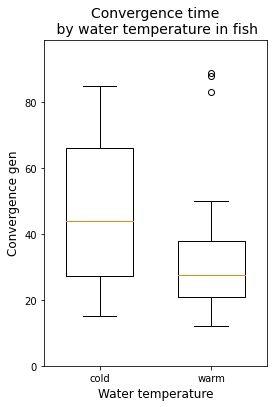

MannwhitneyuResult(statistic=967.5, pvalue=0.010868813918505388)
SpearmanrResult(correlation=0.07611270132906496, pvalue=0.6497016702198524)


In [15]:
q_dict_FT = {}
quartiles = 2
analysed_species = ft[(ft.Species.isin(zero_4))].groupby('Species').mean() # (ft.Species.isin(sim_AllGenes_Shift)
multipliier = len(analysed_species) // quartiles
for quartile in [quartile for quartile in range(quartiles)]:
    q_dict_FT[quartile+1] = analysed_species.sort_values(by='Temperature').index.values[quartile*multipliier:(quartile+1)*multipliier]
# q_dict

print(len(q_dict_FT[1]))

dRhoFT_dict_T = {}
for quartile in q_dict_FT:
    vals = [deltaRho_ShiftMean_Time[species] for species in q_dict_FT[quartile]]
    dRhoFT_dict_T[quartile] = vals


    
fig, ax = plt.subplots(figsize=(4, 6))
ax.boxplot(dRhoFT_dict_T.values(), widths=0.6)
ax.set_xticklabels(['cold', 'warm']) # ['cold', 'warm'] or dRhoFT_dict_T.keys()
plt.title('Convergence time\n by water temperature in fish', fontsize=14)
plt.xlabel('Water temperature', fontsize=12) # \'s quartiles\n cool -> warm
plt.ylabel('Convergence gen', fontsize=12)
plt.ylim(bottom=0, top=99)
# plt.savefig(f'Course work pictures\\Results_graphs\\CT_ft.png',bbox_inches='tight')
plt.show()

print(MW(dRhoFT_dict_T[1], dRhoFT_dict_T[quartiles]))
print(spearmanr(dRhoFT_dict_T[1], dRhoFT_dict_T[quartiles]))

## All in one

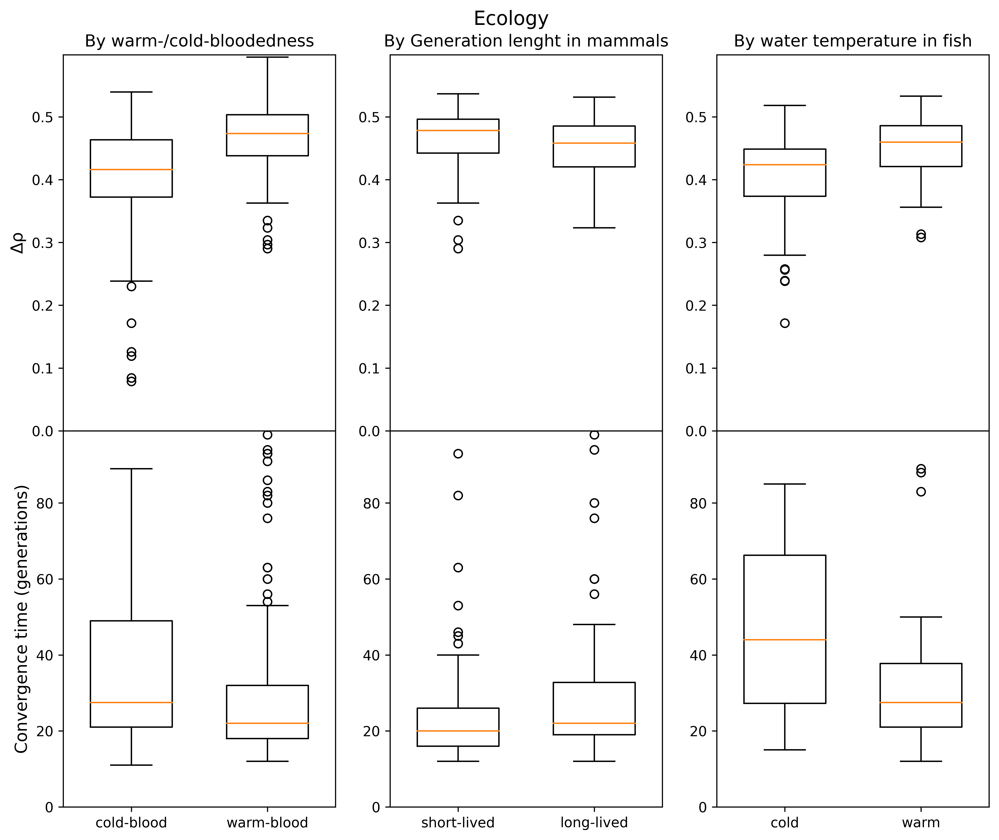

In [16]:
# fig, axs = plt.subplots(nrows=2, ncols=3, sharex=False, figsize=(12, 10), dpi=600)

fig = plt.figure(figsize=(12, 10), dpi=600)
gs = fig.add_gridspec(nrows=2, ncols=3, hspace=0) # , hspace=0, wspace=0
axs = gs.subplots() # , sharex='row', sharey='row'

fig.suptitle('Ecology', y=0.925, fontsize=14)

axs[0,0].boxplot(warm_cold_dict.values(), widths=0.6)
axs[0,0].set_xticklabels(['', ''])
axs[0,0].set_title('By warm-/cold-bloodedness', fontsize=12) # Δρ by warm-/cold-bloodedness
axs[0,0].set_ylabel('Δρ', fontsize=12)
axs[0,0].set_ylim(bottom=0, top=0.599)
# axs[0,0].sharex(axs[1, 0])

axs[1,0].boxplot(warm_cold_dict_T.values(), widths=0.6)
axs[1,0].set_xticklabels(warm_cold_dict_T.keys())
# axs[1,0].set_title('Convergence time\n by warm-/cold-bloodedness', fontsize=12)
# plt.xlabel('Class', fontsize=12)
axs[1,0].set_ylim(bottom=0, top=99)
axs[1,0].set_ylabel('Convergence time (generations)', fontsize=12)

axs[0,1].boxplot(dRhoGL_dict.values(), widths=0.6)
# axs[0,1].set_xticklabels(['', '']) # dRhoGL_dict.keys()
axs[0,1].set_title('By Generation lenght in mammals', fontsize=12) # Δρ by Generation lenght\nin mammals
# axs[0,1].set_xlabel('Genetation length', fontsize=10) # \'s quartiles\nshort-lived -> long-lived
# axs[0,1].set_ylabel('Δρ', fontsize=12)
axs[0,1].set_ylim(bottom=0, top=0.599)

axs[1,1].boxplot(dRhoGL_dict_T.values(), widths=0.6)
axs[1,1].set_xticklabels(['short-lived', 'long-lived']) # dRhoGL_dict_T.keys() ['short-lived', 'long-lived']
# axs[1,1].set_title('Convergence time by Generation\nlength in mammals', fontsize=12)
# plt.xlabel('Genetation length\'s quartiles\nshort-lived -> long-lived', fontsize=12) # \'s quartiles
# axs[1,1].set_ylabel('Convergence gen', fontsize=10)
axs[1,1].set_ylim(bottom=0, top=99)

axs[0,2].boxplot(dRhoFT_dict.values(), widths=0.6)
axs[0,2].set_xticklabels(['', '']) # ['cold', 'warm'] or dRhoFT_dict.keys()
axs[0,2].set_title('By water temperature in fish', fontsize=12) # Δρ by water temperature in fish
# axs[0,2].set_xlabel('Water temperature', fontsize=12) # cool -> warm
# axs[0,2].set_ylabel('Δρ', fontsize=12)
axs[0,2].set_ylim(bottom=0, top=0.599)

axs[1,2].boxplot(dRhoFT_dict_T.values(), widths=0.6)
axs[1,2].set_xticklabels(['cold', 'warm']) # ['cold', 'warm'] or dRhoFT_dict_T.keys()
# axs[1,2].set_title('Convergence time\n by water temperature in fish', fontsize=12)
# axs[1,2].set_xlabel('Water temperature', fontsize=12) # \'s quartiles\n cool -> warm
# axs[1,2].set_ylabel('Convergence gen', fontsize=12)
axs[1,2].set_ylim(bottom=0, top=99)

# fig.supylabel('down            up', fontsize=14) # , y=0.3
plt.savefig('Course work pictures\\Results_graphs\\Total ecology.pdf', bbox_inches='tight')
plt.show()

In [33]:
import shutil
for folder in ['Amblyrhynchus_cristatus', 'Anas_crecca', 'Anguilla_japonica', 'Anguilla_malgumora', 
                'Bagarius_yarrelli', 'Bipes_biporus', 'Blanus_cinereus', 'Channa_marulius', 'Crocidura_orientalis', 'Crocuta_crocuta', 
                'Eptesicus_serotinus', 'Eurycea_bislineata', 'Gloydius_saxatilis', 'Hippocampus_erectus', 'Hypomesus_olidus',
                'Marmota_himalayana', 'Metachirus_nudicaudatus', 'Moschus_berezovskii', 'Scaphirhynchus_platorynchus', 'Tonatia_saurophila', 
                'Tor_khudree']:
    shutil.rmtree(f'Practice/Results_AllGenes_shift/{folder}')

# Codons by frequency changing 

AAA    0.026238
AAC    0.064486
AAG        2.65
AAT    0.123214
ACA    0.090764
         ...   
TGT    0.683333
TTA    0.308772
TTC    0.053759
TTG    0.128571
TTT    0.072959
Name: Mus_musculus, Length: 64, dtype: object

In [3]:
CodonChanging = pd.DataFrame(index=sim_AllGenes_Shift, columns=['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC',
       'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT',
       'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT', 'CTA', 'CTC',
       'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT',
       'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAA', 'TAC',
       'TAG', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGA', 'TGC', 'TGG', 'TGT',
       'TTA', 'TTC', 'TTG', 'TTT'])

for species in sim_AllGenes_Shift:
    freq_table = pd.read_csv('Practice\Results_AllGenes_shift\{}\FrequenciesMean.csv'.format(species), sep='\t').copy()
    codon_freq_0 = {}
    codon_freq_225 = {} # {codon:codon_frequency for codon in freq_table.columns for codon_frequency in freq_table.iloc[224]}
    for i in range(64):
        codon_freq_0[freq_table.columns[i]] = freq_table.iloc[1][i]
        codon_freq_225[freq_table.columns[i]] = freq_table.iloc[225][i]
    codon_changing = {}
    codon_changing_percentage = {}
    for codon in codon_freq_0:
        if codon in unambiguous_dna_by_id[table].stop_codons:
            codon_changing[codon] = 0
            codon_changing_percentage[codon] = 0
            continue
        codon_changing[codon] = codon_freq_0[codon] - codon_freq_225[codon]
        codon_changing_percentage[codon] = (codon_freq_0[codon] - codon_freq_225[codon]) / codon_freq_0[codon]

    CodonChanging.loc[species] = list(codon_changing_percentage.values())

In [82]:
CodonChanging = CodonChanging.convert_dtypes()
CodonChanging.to_csv('CodonChanging.csv', sep='\t', index=False)

In [3]:
CodonChanging = pd.read_csv('CodonChanging.csv', sep='\t').copy()
CodonChanging.head()

,Species,AAA,AAC,AAG,AAT,ACA,ACC,ACG,ACT,AGA,...,TCG,TCT,TGA,TGC,TGG,TGT,TTA,TTC,TTG,TTT
0,Abbottina_rivularis,-0.799266,-0.301760,0.878869,0.308483,-1.627401,0.366135,0.847128,0.576238,0,...,0.855051,0.632603,-1.163366,-0.685864,0.896947,0.453287,-0.279446,-0.575578,0.928839,0.457070
1,Abramis_brama,-0.690977,0.997403,0.786217,-1.006114,-1.538128,1.000000,0.677355,0.146452,0,...,0.618026,0.067974,-0.887558,0.996000,0.792593,-1.185714,-4.100550,0.998017,0.524922,-2.230428
2,Abudefduf_vaigiensis,-0.678571,-0.730476,0.703704,0.594574,-0.524537,-0.928712,0.869339,0.333057,0,...,0.828169,0.436813,-0.773684,-0.458955,0.747458,0.530172,0.497400,-0.630149,0.916749,0.577354
3,Acanthogobius_hasta,-0.630065,-0.412844,0.674126,0.468750,-0.656740,-0.719374,0.680207,0.458768,0,...,0.762677,0.053333,-0.780795,-0.255385,0.700609,0.353191,0.418296,-0.520242,0.859163,0.496668
4,Acanthopagrus_schlegelii,-0.479167,-0.210117,0.851852,0.271357,0.222441,-1.468439,0.975446,-0.290000,0,...,0.954967,0.007682,-0.896341,-0.246429,0.909011,0.345000,0.493317,-0.257962,0.968114,0.313346


In [11]:
CodonChanging[CodonChanging.Species == 'Abramis_brama'].iloc[0][1:].abs().sort_values(ascending=False)

4.100550275137582

In [ ]:
dict(sorted(codon_changing_percentage.items(), key=lambda item: item[1], reverse=True))

{'AAG': 2.650000000000163,
 'AGT': 1.8090909090910106,
 'CCG': 1.5,
 'GGG': 0.8025000000000151,
 'TGT': 0.6833333333334719,
 'CTG': 0.6666666666666711,
 'TCG': 0.5833333333334235,
 'ATG': 0.5782608695652242,
 'ATC': 0.5474452554744509,
 'CTC': 0.5351562499999942,
 'GAG': 0.5333333333333093,
 'GTG': 0.5142857142857291,
 'CGG': 0.5000000000000603,
 'TGG': 0.3900000000000694,
 'GCC': 0.35722891566265413,
 'GCA': 0.3484042553191447,
 'GTT': 0.3447368421052585,
 'ATT': 0.3409090909090917,
 'CCC': 0.33382352941176685,
 'TTA': 0.30877192982456214,
 'AGC': 0.29142857142857853,
 'CGT': 0.2687499999999734,
 'ACG': 0.2399999999999536,
 'TGC': 0.22777777777776553,
 'GGC': 0.2205128205128333,
 'CCT': 0.21607142857142475,
 'GTA': 0.21159420289855146,
 'TCA': 0.19517241379310088,
 'TAT': 0.18928571428571675,
 'GGT': 0.1884615384615273,
 'CAG': 0.1833333333333512,
 'TAC': 0.17666666666666928,
 'TCT': 0.17125000000000748,
 'CCA': 0.15813953488372248,
 'CTT': 0.15416666666666393,
 'CAT': 0.1426470588235

In [18]:
for most_changed_codon in CodonChanging.mean().nlargest(10).index:
    print(most_changed_codon)
print('\n')
for most_changed_codon in CodonChanging.mean().nsmallest(10).index:
    print(most_changed_codon)

TTG
GAG
GGG
GCG
GTG
AAG
ATG
CGG
TGG
TCG


CTA
CGA
GTA
GGA
GCA
CCA
ACA
TCA
TGA
AAA


C:\Users\D2B0~1\AppData\Local\Temp/ipykernel_16140/2446823529.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for most_changed_codon in CodonChanging.mean().nlargest(10).index:
C:\Users\D2B0~1\AppData\Local\Temp/ipykernel_16140/2446823529.py:4: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for most_changed_codon in CodonChanging.mean().nsmallest(10).index:


# Codon cognation

In [11]:
trna = pd.read_csv('Practice/TRNASpeciesandGibbs.txt', sep='\t').copy()
trna.head()

,trna,species,id,parameter,anticodon,sequence,SecondaryStructure,GibbsEnergy,GenerationLength_d,LongLived,TimeBeingSingleStrangedForAll,GeneCodedOnLightChain
0,Ala,Bos_javanicus,mtdbD00000358,9906,TGC,GAGGAUUUAGCUUAAUUAAAGUGGUUGAUUUGCAUUCAAUUGAUGU...,((((((...((((.....))))((((((.......))))))..(((...,-12.8,3285.0000,1,16437,1
1,Ala,Artibeus_jamaicensis,mtdbD00005138,9417,TGC,AAGGGCUUAGCUUAAUUAAAGUAGUUGAUUUGCAUUCAGCAGAUGU...,((((((((((((..........)))))((((((.....))))))((...,-18.7,1920.4777,1,16437,1
2,Ala,Tursiops_aduncus,mtdbD00001302,79784,TGC,GAGGAUUUAGCUUAAUUAAAGUGUUUGAUUUGCAUUCAAUUGAUGU...,((((((.....((((((..(((((.......))))).))))))(((...,-13.8,6427.8800,1,16437,1
3,Ala,Acinonyx_jubatus,mtdbD00000446,32536,TGC,GAGGACUUAGCUUAAUUAAAGUGUUUGAUUUGCAGUCAAUUGAUGU...,(((((((..((..(((((((...))))))).)).(((....)))((...,-15.6,2190.0000,1,16437,1
4,Ala,Vombatus_ursinus,mtdbD00002685,29139,TGC,GAGAAUUUAGCUUAAUUAAAGUAUUCGAUUUGCGUUCGGAUGAUGC...,(((((((.(((((.(((....(((((((.......))))))).......,-13.8,3542.0140,1,16437,1


In [30]:
outs = []
for species in zero_4:
    if species in set(trna.species):
        outs.append(species)
len(outs)

55

In [18]:
from Bio import SeqIO

records = list(SeqIO.parse("Practice/MammallianTrnasFasta.fst", "fasta"))

In [29]:
cross = set()
for i in range(len(records)):
    species = records[i].id.split('|')[1]
    if species in zero_4:  # ['mtdbD00000446', 'Acinonyx_jubatus', '32536', 'Ala', 'TGC']
        cross.add(species)
len(cross)

63

# Supplements

In [103]:
# Species, MutSpec(12 col), Gene, Codon usage(64 col), Ecology(GenLength, WaterTemp), final Δρ
Suppl_table = pd.DataFrame(columns=['Species', 'A>T', 'A>G', 'A>C', 'T>A', 'T>G', 'T>C', 'G>A', 'G>T', 'G>C', 'C>A', 'C>T', 'C>G',
                                   'AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT', 'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 
                                   'ATG', 'ATT', 'CAA', 'CAC', 'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT',
                                   'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC', 'GCG', 'GCT', 'GGA', 'GGC', 
                                   'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT', 'TAA', 'TAC', 'TAG', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT',
                                   'TGA', 'TGC', 'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT', 'GenLength', 'WaterTemp', 'final Δρ'])

# species = 'Mus_musculus'
for species in sim_AllGenes_Shift:
    mutspec = ms[ms.Species == species].values[0][1:] # array 
    codons = ['AAA', 'AAC', 'AAG', 'AAT', 'ACA', 'ACC', 'ACG', 'ACT',
           'AGA', 'AGC', 'AGG', 'AGT', 'ATA', 'ATC', 'ATG', 'ATT', 'CAA', 'CAC',
           'CAG', 'CAT', 'CCA', 'CCC', 'CCG', 'CCT', 'CGA', 'CGC', 'CGG', 'CGT',
           'CTA', 'CTC', 'CTG', 'CTT', 'GAA', 'GAC', 'GAG', 'GAT', 'GCA', 'GCC',
           'GCG', 'GCT', 'GGA', 'GGC', 'GGG', 'GGT', 'GTA', 'GTC', 'GTG', 'GTT',
           'TAA', 'TAC', 'TAG', 'TAT', 'TCA', 'TCC', 'TCG', 'TCT', 'TGA', 'TGC',
           'TGG', 'TGT', 'TTA', 'TTC', 'TTG', 'TTT']
    codonusage_df = pd.read_csv('Practice/CodonUsageSummary.csv', sep='\t').copy()
    codonusage = codonusage_df[codonusage_df.Species == species].values[0][1:-1]
    if species in gl.Scientific_name.values:
        genlength = float(gl[gl.Scientific_name == species]['GenerationLength_d'].values[0])
    else: 
        genlength = pd.NA
    if species in ft.Species.values:
        fishtemp = float(ft[ft.Species == species].groupby('Species').mean().iloc[0].values[0])
    else: 
        fishtemp = pd.NA
    finaldeltarho = float(deltaRho_ShiftMean[species][224])
    row = [species] + list(mutspec) + list(codonusage) + [genlength] + [fishtemp] + [finaldeltarho]
    Suppl_table.loc[len(Suppl_table)] = row
Suppl_table

,Species,A>T,A>G,A>C,T>A,T>G,T>C,G>A,G>T,G>C,...,TGC,TGG,TGT,TTA,TTC,TTG,TTT,GenLength,WaterTemp,final Δρ
0,Abbottina_rivularis,0.011369,0.028350,0.013839,0.059072,0.007981,0.128591,0.473568,0.051221,0.079542,...,12,24,12,100,113,11,97,NaN,NaN,0.390678
1,Abramis_brama,0.014698,0.073491,0.000000,0.044764,0.000000,0.000000,0.622380,0.000000,0.000000,...,12,9,11,111,121,11,98,NaN,6.922727,-0.130835
2,Abudefduf_vaigiensis,0.000000,0.063498,0.021166,0.010499,0.010499,0.283484,0.424866,0.030348,0.060695,...,19,12,6,58,148,8,83,NaN,27.0,0.485345
3,Acanthogobius_hasta,0.014626,0.106742,0.044787,0.000000,0.023947,0.062424,0.596688,0.050615,0.000000,...,17,17,11,76,96,16,124,NaN,<NA>,0.410564
4,Acanthopagrus_schlegelii,0.090170,0.011128,0.064126,0.065980,0.006766,0.196450,0.225208,0.106133,0.105267,...,18,13,6,96,128,12,101,NaN,<NA>,0.428413
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,Viverricula_indica,0.006343,0.014951,0.002287,0.015717,0.004829,0.145174,0.620724,0.014263,0.044240,...,15,3,6,151,117,7,109,1658.835,<NA>,0.488851
556,Vulpes_vulpes,0.002086,0.082425,0.002556,0.020244,0.000000,0.203006,0.498892,0.011867,0.014301,...,17,11,5,83,133,22,83,2105.3972,<NA>,0.423149
557,Vulpes_zerda,0.084571,0.000000,0.000000,0.127185,0.000000,0.254370,0.273448,0.000000,0.000000,...,17,10,5,85,139,21,76,1878.788155,<NA>,0.361424
558,Xiphias_gladius,0.002361,0.128887,0.007451,0.009377,0.004689,0.126679,0.643480,0.008959,0.008959,...,19,22,3,55,137,8,86,<NA>,20.6125,0.361433


In [105]:
Suppl_table.to_csv('Course work pictures\Suppl_table.csv', index=False)

In [5]:
Supplement = pd.read_csv('Course work pictures\Suppl_table.csv').copy()
Supplement.head()

,Species,A>T,A>G,A>C,T>A,T>G,T>C,G>A,G>T,G>C,...,TGC,TGG,TGT,TTA,TTC,TTG,TTT,GenLength,WaterTemp,final Δρ
0,Abbottina_rivularis,0.011369,0.028350,0.013839,0.059072,0.007981,0.128591,0.473568,0.051221,0.079542,...,12,24,12,100,113,11,97,NaN,NaN,0.390678
1,Abramis_brama,0.014698,0.073491,0.000000,0.044764,0.000000,0.000000,0.622380,0.000000,0.000000,...,12,9,11,111,121,11,98,NaN,6.922727,-0.130835
2,Abudefduf_vaigiensis,0.000000,0.063498,0.021166,0.010499,0.010499,0.283484,0.424866,0.030348,0.060695,...,19,12,6,58,148,8,83,NaN,27.000000,0.485345
3,Acanthogobius_hasta,0.014626,0.106742,0.044787,0.000000,0.023947,0.062424,0.596688,0.050615,0.000000,...,17,17,11,76,96,16,124,NaN,NaN,0.410564
4,Acanthopagrus_schlegelii,0.090170,0.011128,0.064126,0.065980,0.006766,0.196450,0.225208,0.106133,0.105267,...,18,13,6,96,128,12,101,NaN,NaN,0.428413


In [15]:
Supplement[Supplement.Species=='Balaena_mysticetus'].loc[:,['Species','CCC','CCT']]

,Species,CCC,CCT
71,Balaena_mysticetus,84,45
